# CLASE 3.3: PERSONALIZACIÓN Y CONFIGURACIONES ADICIONALES.
---
Vamos a expandir nuestra caja de herramientas de **Matplotlib** añadiendo algunas opciones de personalización importantes para varios de los elementos que constituyen un gráfico, incluyendo leyendas, barras de color y marcas de graduación de ejes. También profundizaremos en algunas configuraciones adicionales que incluyen la creación de figuras con varios paneles que soporten gráficos y la incorporación de texto y anotaciones.

Como siempre, partiremos realizando las correspondientes importaciones que usaremos en esta sección:

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [2]:
%matplotlib notebook

In [3]:
# Setting de parámetros de graficación.
plt.style.use("ggplot") # Template.
plt.rcParams["figure.dpi"] = 100 # Resolución de nuestras figuras.

## Personalización de leyendas.
Las leyendas de un gráfico otorgan sentido a la visualización de información, asignándole una referencia concreta a varios de sus elementos. Anteriormente, vimos como crear una leyenda sencilla. Pero ahora estudiaremos como personalizar los elementos estructurales y estéticos de una leyenda.

La leyenda, en su versión más sencilla, puede agregarse a un gráfico mediante la función `plt.legend()` en el caso de usar la interfaz de tipo de Matlab, o el método `ax.legend()` si usamos la interfaz orientada a objetos (y ambos aceptan exactamente los mismos argumentos). En ambos casos, automáticamente se crea una leyenda para cualquier objeto del gráfico que posea un rótulo asignado previamente mediante alguna función de graficación, usando el parámetro `label`:

<IPython.core.display.Javascript object>


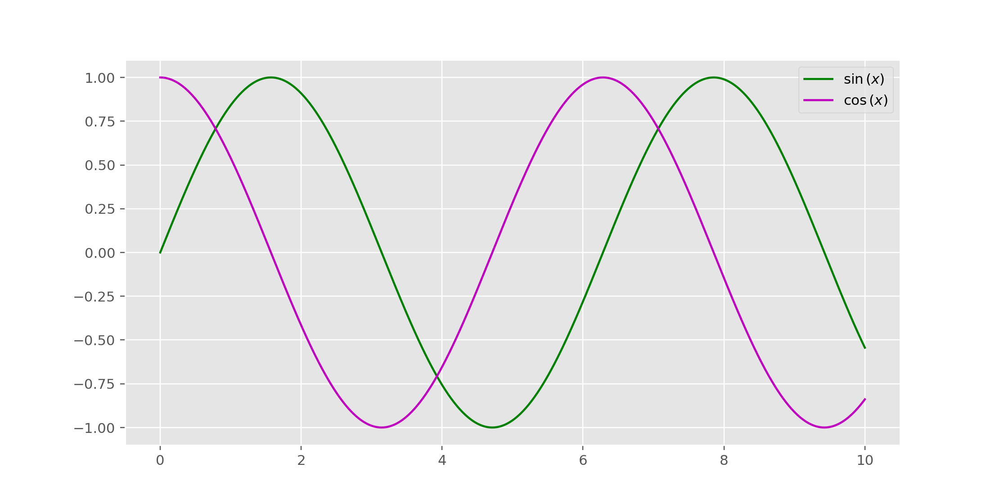

In [4]:
# Partimos creando una secuencia de datos.
x = np.linspace(start=0, stop=10, num=500)

# Construimos un gráfico con leyendas sencillas.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), "-g", label=r"$\sin{(x)}$")
ax.plot(x, np.cos(x), "-m", label=r"$\cos{(x)}$")
ax.legend();

La leyenda del gráfico anterior cumple con el objetivo de referenciar correctamente qué significa cada una de las líneas que conforman dicho gráfico. Sin embargo, el método `legend()` acepta algunos argumentos adicionales. Uno de ellos es `loc`, que corresponde a un string que permite especificar la localización de la leyenda en el panel correspondiente. Por ejemplo, `loc="upper right"` permitirá ubicar la leyenda en la parte superior derecha del panel; `loc="center down"` ubicará la leyenda en el sector central inferior del gráfico; y `loc="lower left"` ubicará la leyenda en el sector inferior izquierdo del panel.

Otro elemento importante de una leyenda corresponde a la caja en la cual se dibuja la referencia correspondiente de cada gráfico, la que se conoce en la terminología de **Matplotlib** como *"frame"*. De esta manera, podemos diferenciar dicha caja del fondo del gráfico correspondiente mediante el parámetro Booleano `frameon`:

<IPython.core.display.Javascript object>


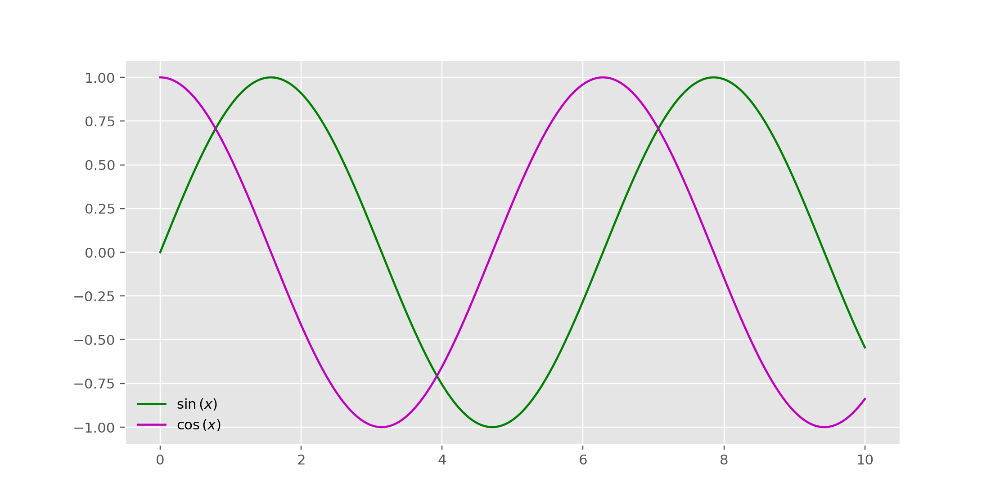

In [5]:
# Manipulamos algunos aspectos relativos a la leyenda.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), "-g", label=r"$\sin{(x)}$")
ax.plot(x, np.cos(x), "-m", label=r"$\cos{(x)}$")
ax.legend(loc="lower left", frameon=False);

Por cierto, el parámetro `loc` acepta un valor llamado `"best"`, que permite que **Matplotlib** infiera la mejor posición de la leyenda en función de lo que dibujemos conforme cada función de graficación.

Otros parámetros que podemos manipular en el método `legend()` corresponden a `ncol`, que permite definir el número de columnas en las cuales se divide la leyenda; `framealpha`, que permite determinar la transparencia asociada al *frame* donde se dibuja la leyenda (y cuyo valor es de 0 a 1, desde más a menos transparencia); `fancybox`, que nos permite dibujar un *frame* no tan simple como el que está definido por defecto, y que es Booleano; `borderpad`, que es un argumento numérico que corresponde al tamaño del *frame* que contiene a la leyenda; y `shadow`, que es un parámetro Booleano que permite definir si el frame de la leyenda tendrá dibujada una sombra a modo de efecto 3D:

<IPython.core.display.Javascript object>


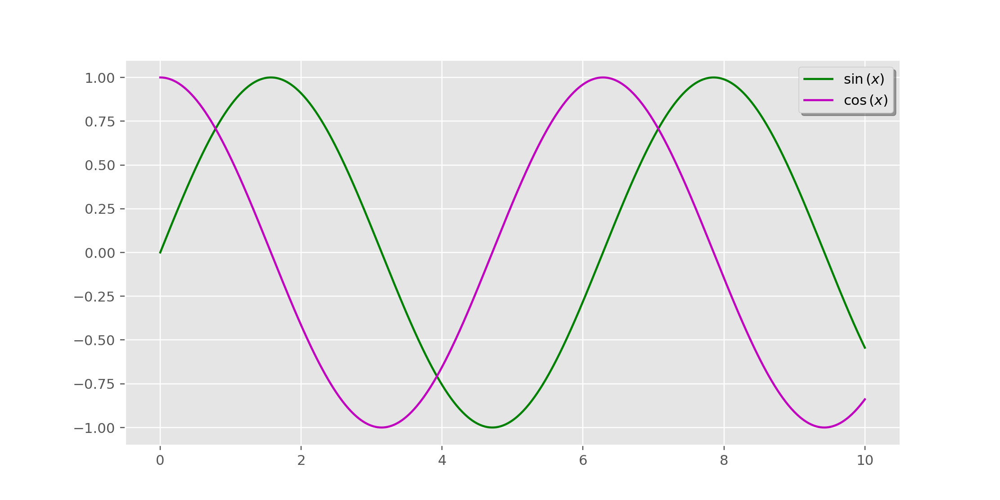

In [6]:
# Manipulamos columnas y el tipo de frame.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), "-g", label=r"$\sin{(x)}$")
ax.plot(x, np.cos(x), "-m", label=r"$\cos{(x)}$")
ax.legend(loc="best", shadow=True);

<IPython.core.display.Javascript object>


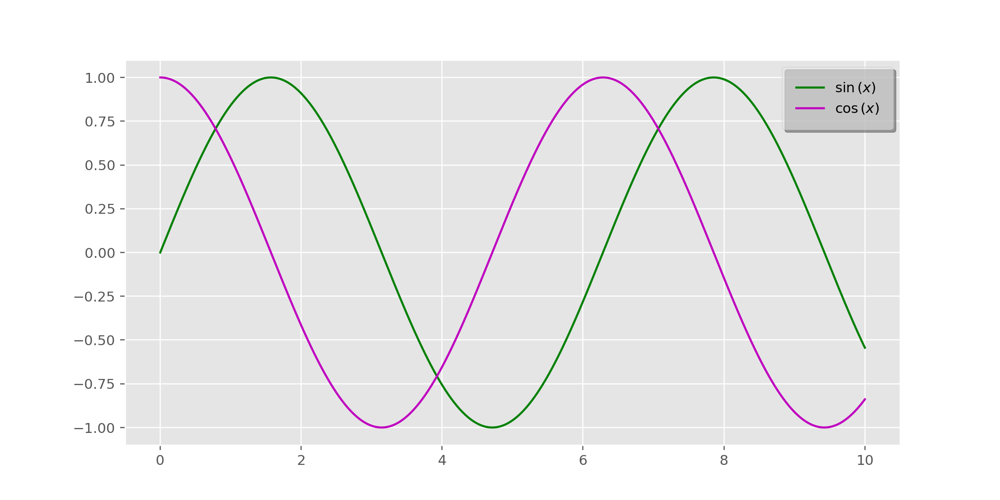

In [8]:
# Manipulamos más elementos de la leyenda.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), "-g", label=r"$\sin{(x)}$")
ax.plot(x, np.cos(x), "-m", label=r"$\cos{(x)}$")
ax.legend(loc="best", shadow=True, fancybox=True, borderpad=1, framealpha=0.6);

Como ya hemos visto previamente, una leyenda incluye todos los elementos que han sido previamente rotulados en las funciones constructoras de gráficos. Si esto no es lo que queremos, podemos ajustar manualmente cuáles elementos y rótulos aparecerán en nuestro cuadro de leyenda, usando los objetos retornados por las funciones de tipo `ax.plot()`. Por ejemplo, dicha función es capaz de crear múltiples líneas al mismo tiempo, retornando a su vez una lista con las instancias creadas. Si pasamos cualquiera de estas instancias a la función `ax.legend()`, automáticamente le indicará a dicha función qué rótulos identificar:

In [10]:
# Generamos un arreglo con cuatro columnas para probar lo anterior.
y = np.exp(-x.reshape(-1, 1) + 2*np.arange(start=0, stop=2, step=0.5))

<IPython.core.display.Javascript object>


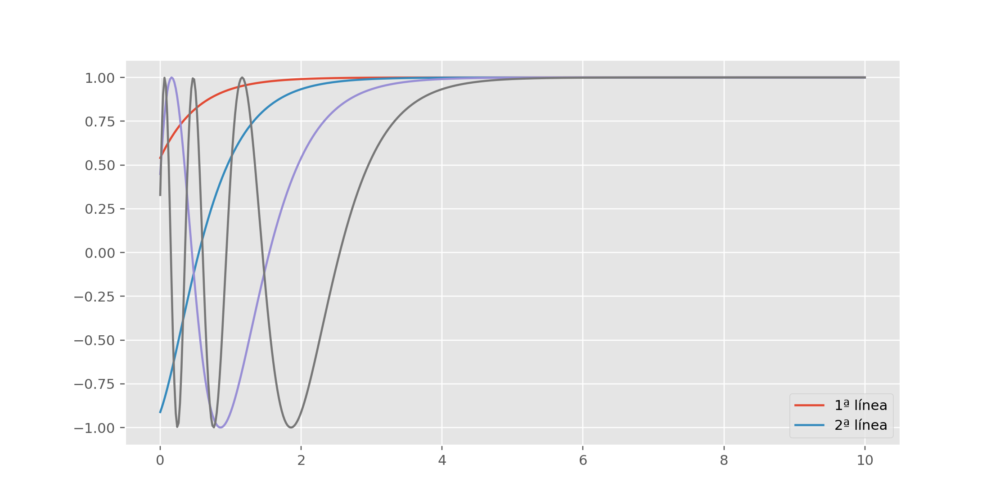

In [11]:
# Generamos un objeto que permite instanciar un gráfico de líneas para estas cuatro columnas.
plt.figure(figsize=(10, 5))
lines = plt.plot(x, np.cos(y))
plt.legend(lines[:2], ["1ª línea", "2ª línea"]);

Vemos pues que hemos forzado a que la leyenda solamente haga referencia a las primeras dos líneas graficadas, dejando las otras dos sin referencia alguna.

A veces, las opciones por defecto en las leyendas no son suficientes para las respectivas visualizaciones de información. Por ejemplo, quizás queramos utilizar el tamaño de los puntos en un gráfico de dispersión para demarcar ciertos atributos de nuestra data y, por extensión, nuestro interés sea que la leyenda muestre aquella información. Para ejemplificar lo anterior, haremos uso de un dataset relativo a la producción anual detallada por punto de extracción en una mina subterránea

**Ejemplo 3.1 - Leyenda asociada al tamaño de puntos:** La ubicación del dataset a utilizar es `datasets/pex_data.xlsx`:

In [12]:
# Accedemos a la data.
data = pd.read_excel("datasets/pex_data.xlsx")

In [13]:
# Mostramos las primeras filas de este DataFrame.
data.head()

,PEX,X,Y,ALT. EXTRAIBLE,PRODUCCION
0,33131H,1622.804335,-4174.759559,179.182548,194.851985
1,33132F,1637.693801,-4181.208870,216.512245,41.559977
2,33132H,1635.052940,-4162.514765,167.983638,202.235380
3,33133F,1649.951066,-4168.959076,215.765651,166.610602
4,33133H,1647.310205,-4150.264971,216.512245,261.675387


Dado que cada uno de los puntos de extracción que constituyen esta mina subterránea se encuentra individualizado por su denominación (que es dependiente de la combinación calle - zanja correspondiente), es una buena práctica indexar este DataFrame con respecto a la columna `"PEX"` de forma previa a construir nuestro gráfico:

In [14]:
# Indexamos nuestra data con respecto al nombre de cada punto de extracción.
data.set_index("PEX", inplace=True)

Vamos a mostrar cuatro dimensiones de información en un gráfico de dispersión, considerando las coordenadas mina de cada punto de extracción como dimensiones espaciales; la altura extraíble será identificada por medio del tamaño de cada punto, y la producción asociada a cada uno se referenciará por medio de su color. Una idea para esto podría ser la siguiente:

<IPython.core.display.Javascript object>


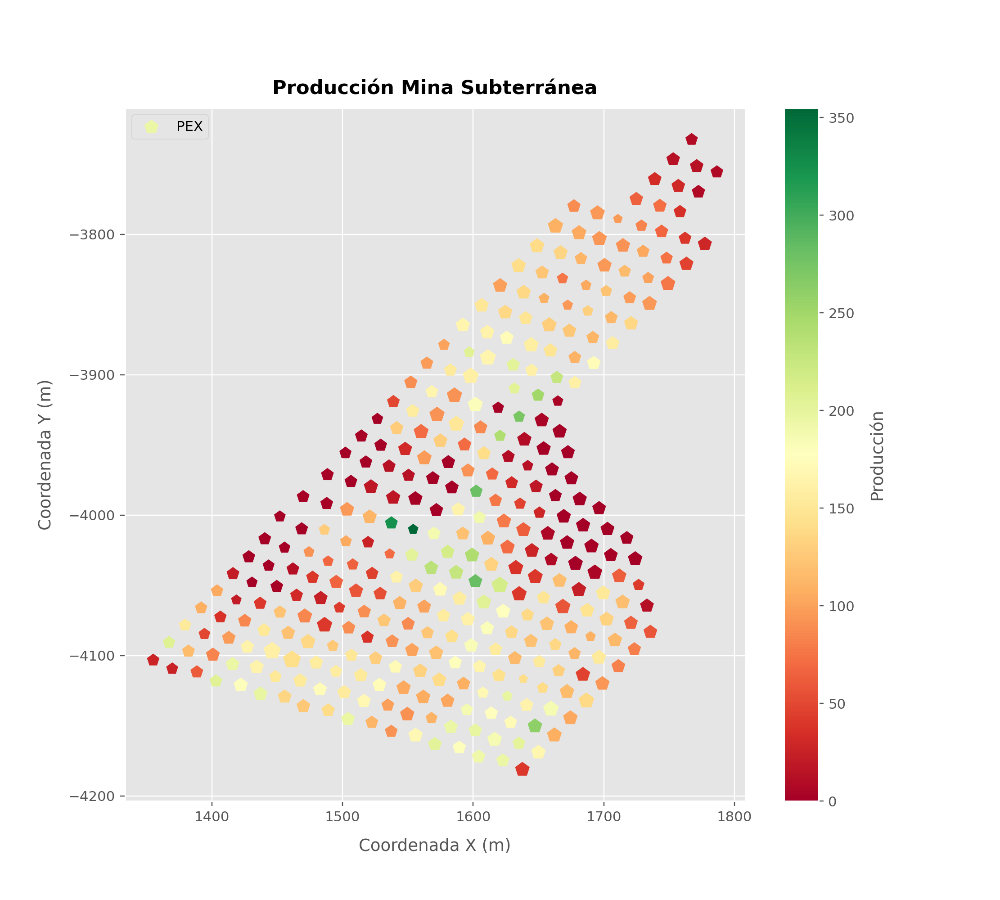

In [15]:
# Una primera aproximación para graficar la data de alturas y producción por cada PEX.
fig, ax = plt.subplots(figsize=(10, 9))
p = ax.scatter(
    x=data["X"], y=data["Y"], s=data["ALT. EXTRAIBLE"]/2, 
    c=data["PRODUCCION"], cmap="RdYlGn", label="PEX", marker ="p"
)
ax.set_xlabel("Coordenada X (m)", fontsize=12, labelpad=10)
ax.set_ylabel("Coordenada Y (m)", fontsize=12, labelpad=10)
ax.set_title("Producción Mina Subterránea", fontsize=14, fontweight="bold", pad=10)
cbar = plt.colorbar(p)
cbar.set_label("Producción", fontsize=12, labelpad=10)
ax.legend(loc="upper left");

El gráfico anterior pareciera no tener ningún problema. Sin embargo, la leyenda creada mediante el método `ax.legend()` solamente nos indica que cada punto en este gráfico es, de hecho, un punto de extracción. Pero no tenemos ninguna referencia acerca de los tamaños de cada uno y, por esa razón, no tenemos forma de saber qué significa esa información. Por ello, debemos manipular un poco el método `ax.legend()`, además de referenciar correctamente la información de las alturas extraíbles (que es la data que está siendo representada por el tamaño de cada punto):

<IPython.core.display.Javascript object>


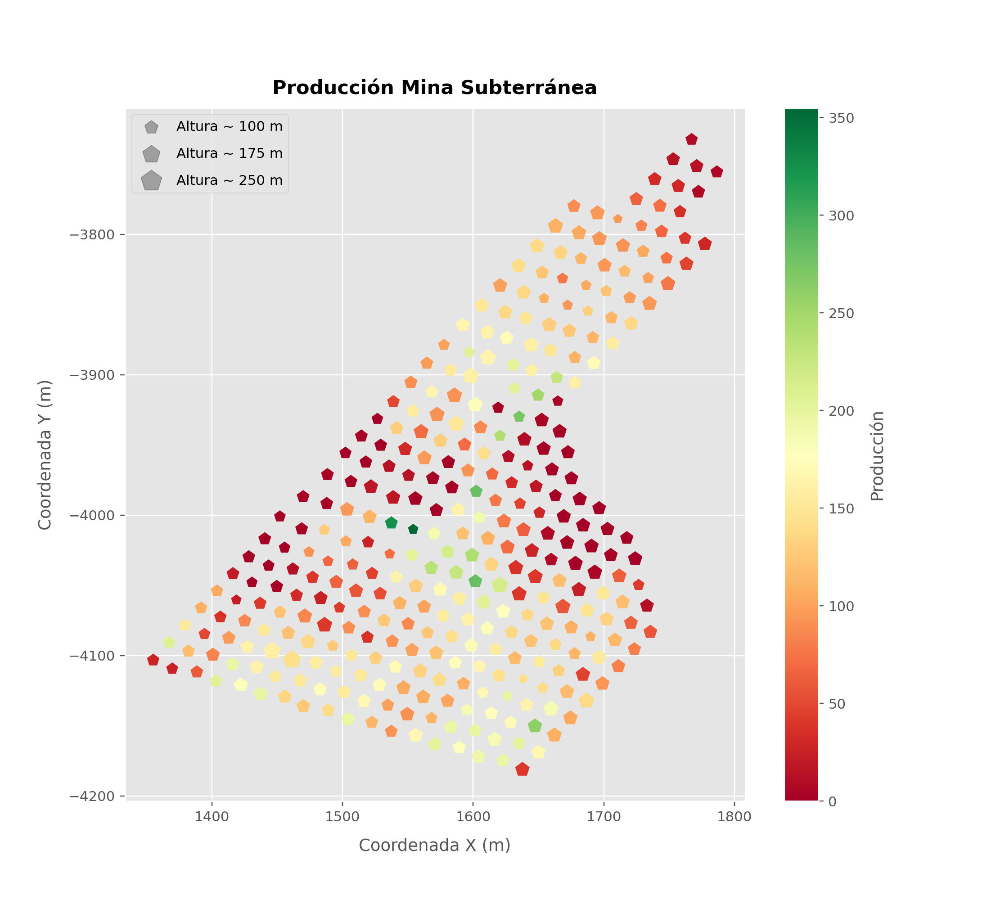

In [16]:
# Una primera aproximación para graficar la data de alturas y producción por cada PEX.
fig, ax = plt.subplots(figsize=(10, 9))
p = ax.scatter(
    x=data["X"], y=data["Y"], s=data["ALT. EXTRAIBLE"]/2, 
    c=data["PRODUCCION"], cmap="RdYlGn", marker ="p"
)
ax.set_xlabel("Coordenada X (m)", fontsize=12, labelpad=10)
ax.set_ylabel("Coordenada Y (m)", fontsize=12, labelpad=10)
ax.set_title("Producción Mina Subterránea", fontsize=14, fontweight="bold", pad=10)
cbar = plt.colorbar(p)
cbar.set_label("Producción", fontsize=12, labelpad=10)

# Aquí es donde crearemos la leyenda correcta para este gráfico.
for height_j in [100, 175, 250]:
    ax.scatter([], [], marker="p", c="k", alpha=0.3, s=height_j, label="Altura ~ "+str(height_j)+" m")
    ax.legend(scatterpoints=1, frameon=True, labelspacing=1);

Y ahora sí nuestra leyenda referencia correctamente la información que queremos comunicar. Para ello, hicimos uso del parámetro `scatterpoints`, que nos permite referenciar a qué gráfico de dispersión apunta la leyenda mostrada en el panel (en este caso, su valor es `1`, porque hace referencia sólo al gráfico vacío definido por la instrucción `ax.scatter([], [], c="k", alpha=0.3, s=height_j, label=str(height_j)+" m")`. Además de ello, usamos el parámetro `labelspacing`, simplemente para especificar cuántas unidades verticales (en magnitud de tamaño de fuente) separan cada entrada de la leyenda. Esta es una forma simple, pero efectiva, de *engañar* a **Matplotlib**.

## Creación de ejes secundarios.
Hasta ahora, hemos tenido el cuidado de aprender paso a paso cómo crear gráficos bidimensionales siempre con el mismo esquema: Usar solamente dos ejes de graficación en una correspondencia uno a uno. No obstante, **Matplotlib** dispone de herramientas que nos permiten aumentar la cantidad de ejes de graficación.

Tomemos el ejemplo de dos ejes verticales que permiten referenciar dos variables dependientes distintas, las cuales se visualizan en términos de su posible correspondencia con una única variable independiente. Vamos a ejemplificar este caso creando algo de data:

In [19]:
# Semilla aleatoria fija.
rng = np.random.default_rng(42)

In [20]:
# Creamos dos variables dependientes.
y1 = rng.normal(loc=1580, scale=220, size=(24, 1)) # Tratamiento de un molino SAG (tph).
y2 = rng.normal(loc=0.9, scale=0.1, size=(24, 1)) # Ley de Cu de entrada a un molino SAG (en %).

In [21]:
# Creamos un índice de fechas y llevamos todo a un DataFrame.
idx = pd.date_range(start="2021-01-01", end="2022-12-31", freq="M")
data = pd.DataFrame(
    data=np.concatenate([y1, y2], axis=1), 
    index=idx, columns=["Tonelaje", "Ley Cu"]
)

In [22]:
# Mostramos las primeras filas de esta DataFrame.
data.head()

,Tonelaje,Ley Cu
2021-01-31,1647.037758,0.857167
2021-02-28,1351.203497,0.864787
2021-03-31,1745.099263,0.953231
2021-04-30,1786.924238,0.936544
2021-05-31,1150.772258,0.941273


Para construir un eje de graficación vertical adicional, debemos *clonar* el eje horizontal del panel respectivo, de tal forma que el nuevo eje vertical estará definido sobre dicho clon del eje horizontal. Para clonar un eje horizontal, debemos trabajar usando la intefaz orientada a objetos, disponiendo de una figura y el panel respectivo asociados a objetos (que, como establecimos al comenzar nuestro viaje por **Matplotlib**), suelen ser `fig` y `ax`, respectivamente. De esta manera, sobre el panel (el objeto `ax`), usamos el método `ax.twinx()` para obtener un clon del eje horizontal definido en ese panel, asignándolo a otro objeto. Veamos esto por medio de un ejemplo:

<IPython.core.display.Javascript object>


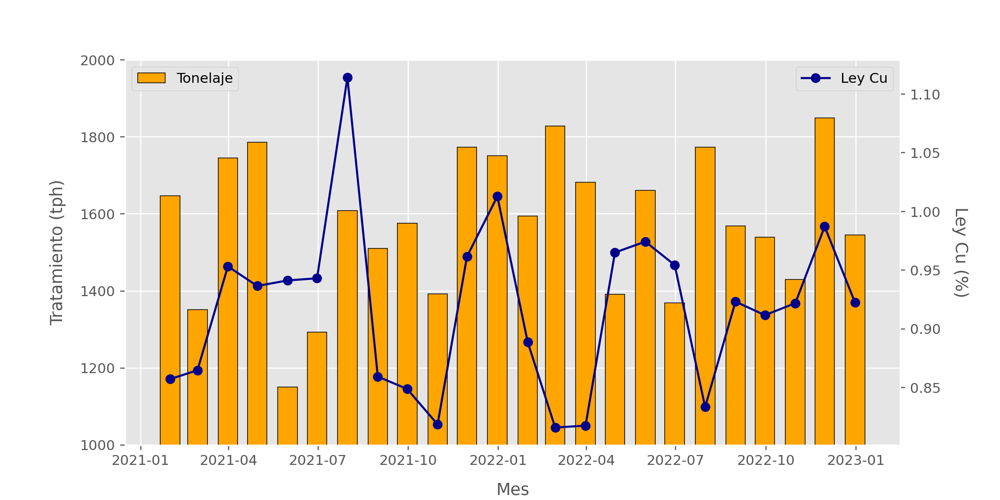

In [23]:
# Un gráfico sencillo con dos ejes verticales asociados a un único eje horizontal.
fig, ax1 = plt.subplots(figsize=(10, 5))
ax2 = ax1.twinx() # Aquí clonamos el eje horizontal.

# El primer gráfico lo dibujamos referido a ax1.
ax1.bar(data.index, data["Tonelaje"], width=20, label="Tonelaje", color="orange", edgecolor="black")

# El segundo gráfico lo dibujamos referido a ax2.
ax2.plot(data.index, data["Ley Cu"], label="Ley Cu", color="darkblue", marker="o")

# Para evitar confusiones, apagamos la grilla de fondo del segundo par de ejes.
ax2.grid(False)

# Y ahora asignamos cada elemento a los pares de ejes correspondientes.
ax1.set_xlabel("Mes", fontsize=12, labelpad=10)
ax1.set_ylabel("Tratamiento (tph)", fontsize=12, labelpad=10)
ax2.set_ylabel("Ley Cu (%)", fontsize=12, labelpad=20, rotation=270)
ax1.set_ylim(1000, 2000)
ax1.legend(loc="upper left")
ax2.legend(loc="upper right");

Todo quedó perfecto, con excepción de la leyenda. Notemos que hay dos leyendas, debido a que cada una de ellas está referida a un panel diferente. Y por lo tanto, se crean dos *frames* distintos. Podemos resolver ésto recuperando cada etiqueta de los gráficos respectivos, concatenándolas y luego asignándolas a la función `ax.legend()`. Para ello usamos el método `get_legend_handles_labels()`, el cual retorna dos objetos: El dibujo del gráfico como tal (que es un objeto que depende del tipo de gráfico; para gráficos de barras, es un objeto del tipo `matplotlib.container.BarContainer`, y para gráficos de líneas, es un objeto del tipo `matplotlib.lines.Line2D`) y las etiquetas que les asignamos a cada uno de ellos mediante el parámetro `label`. Cada uno de estos objetos viene asociado a una lista, por lo que son concatenables. Por lo tanto, sobre cualquiera de los paneles del gráfico, podemos asignar como rótulo de leyenda a la concatenación de cada uno de estos objetos:

<IPython.core.display.Javascript object>


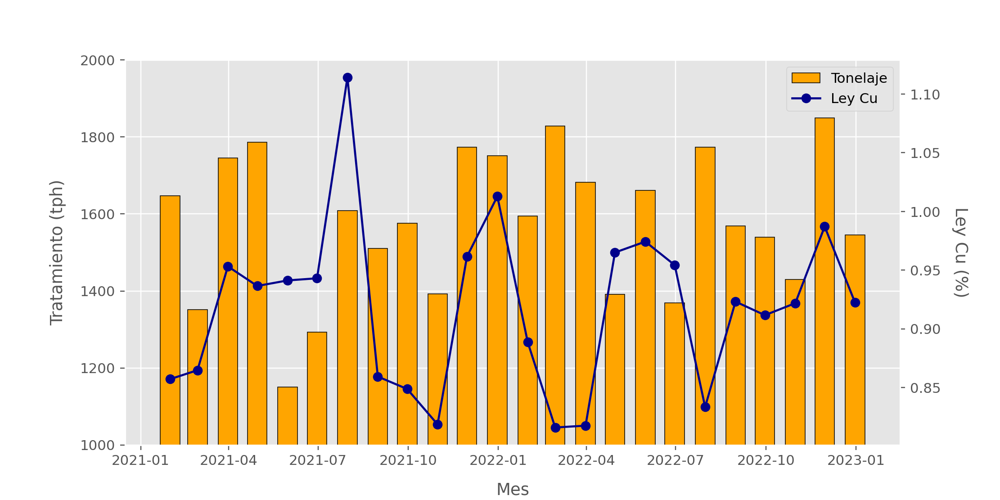

In [24]:
# Lo mismo de antes, pero con la leyenda bien hecha.
fig, ax1 = plt.subplots(figsize=(10, 5))
ax2 = ax1.twinx() # Aquí clonamos el eje horizontal.

# El primer gráfico lo dibujamos referido a ax1.
ax1.bar(data.index, data["Tonelaje"], width=20, label="Tonelaje", color="orange", edgecolor="black")

# El segundo gráfico lo dibujamos referido a ax2.
ax2.plot(data.index, data["Ley Cu"], label="Ley Cu", color="darkblue", marker="o")

# Para evitar confusiones, apagamos la grilla de fondo del segundo par de ejes.
ax2.grid(False)

# Ahora trabajamos la leyenda
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc=0)

# Y ahora asignamos cada elemento a los pares de ejes correspondientes.
ax1.set_xlabel("Mes", fontsize=12, labelpad=10)
ax1.set_ylabel("Tratamiento (tph)", fontsize=12, labelpad=10)
ax2.set_ylabel("Ley Cu (%)", fontsize=12, labelpad=20, rotation=270)
ax1.set_ylim(1000, 2000);

Y ahí ya quedo perfecto nuestro gráfico.

**Ejemplo 3.2 - Construcción de una curva de tonelaje versus ley:** El archivo `datasets/CuAu210.xlsx` contiene los datos relativos a una sección pequeña del inventario de bloques de un sector de interés adyacente a una mina, denominada *NW-215xxx*, la cual es explotada mediante una operación a cielo abierto y cuyo producto principal es cobre, con un subproducto importante de oro. Cada columna representa un conjunto determinado de bloques del modelo respectivo, y cada fila está referida a la ley de cobre y de oro de cada bloque (en ese orden, hacia abajo).

Vamos a suponer que el área de planificación a largo plazo de esta mina está interesada en determinar rápidamente el potencial económico de este sector, a fin de tomar la decisión de incorporarlo en el Plan Minero a Largo a Plazo (PMLP) de la compañía. Por lo tanto, el paso cero de este análisis es construir una curva de tonelaje versus ley equivalente asociada a este sector, para lo cual disponemos de la información técnico-económica detallada en la Tabla (3.1):

<p style="text-align: center;">Tabla (3.1): Información técnica-económica para este ejercicio</p>

| Parámetro de interés    | Valor | Unidad (si corresponde) |
| :---------------------- | :---- | :---------------------- |
| Precio del cobre        | 380   | cUSS/lb                 | 
| Precio del oro          | 1850  | USS/oz                  |
| Recuperación Cu         | 85    | %                       |
| Recuperación Au         | 78    | %                       |
| Costo mina              | 3.2   | USS/t material          |
| Costo planta            | 12.8  | USS/t mineral           |
| Costo remoción estéril  | 0.92  | USS/t material          |
| Costo venta concentrado | 1.00  | US$/lb Cu procesado     |
| Tasa de descuento       | 16    | %                       |
| Ley de concentrado      | 28    | %                       |

También disponemos de información geométrica necesaria para construir la curva de tonelaje versus ley en la Tabla (3.2).

| Parámetro                      | Valor          | Unidad         |
| :----------------------------- | :------------- | :------------- |
| Dimensión en X                 | 25             | m              |
| Dimensión en Y                 | 25             | m              |
| Dimensión en Z                 | 20             | m              |
| Densidad del mineral (in-situ) | 2.8            | $t/m^{3}$      |

Lo primero es acceder al archivo con el inventario de bloques:

In [25]:
# Accedemos al archivo.
blocks = pd.read_excel("datasets/CuAu210.xlsx")

In [26]:
# Observamos las primeras filas de este archivo.
blocks.head()

,Instancia,B1,B2,B3,B4,B5,B6,B7,B8,B9,...,B65,B66,B67,B68,B69,B70,B71,B72,B73,B74
0,Cu_1,0.098,0.085,0.108,0.111,0.105,0.087,0.093,0.099,0.098,...,0.105,0.094,0.113,0.098,0.108,0.099,0.094,0.098,0.100,0.097
1,Au_1,0.075,0.241,0.280,0.394,0.142,0.123,0.115,0.438,0.367,...,0.106,0.196,0.075,0.230,0.357,0.137,0.285,0.159,0.258,0.393
2,Cu_2,0.099,0.102,0.089,0.094,0.093,0.093,0.109,0.103,0.090,...,0.094,0.104,0.099,0.099,0.102,0.100,0.083,0.102,0.094,0.094
3,Au_2,0.565,0.156,0.270,0.433,0.114,0.096,0.228,0.142,0.153,...,0.133,0.142,0.154,0.257,0.126,0.199,0.145,0.311,0.179,0.370
4,Cu_3,0.110,0.103,0.083,0.103,0.103,0.098,0.089,0.125,0.112,...,0.097,0.097,0.086,0.100,0.100,0.096,0.099,0.095,0.098,0.094


Ahora indexamos nuestro inventario conforme las instancias definidas en la primera columna de la base de datos. Esto es importante, ya que la construcción de las curvas de tonelaje vs ley requiere de individualizar cada elemento por bloque:

In [27]:
# Indexamos este DataFrame respecto de cada identificador de fila del inventario.
blocks.set_index("Instancia", inplace=True)

Ahora separamos cada una de las instancias que dan cuenta de las leyes de mineral, a fin de facilitar nuestro trabajo. También visualizaremos las leyes mediante un gráfico de dispersión con un mapa de color adecuado, de manera que podamos tener una idea de la distribución espacial de las leyes de este cuerpo mineralizado:

In [28]:
# Separación de las leyes de cada bloque por elemento de interés.
blocks_cu = blocks.loc[[f"Cu_{j}" for j in range(1, len(blocks)//2 + 1)]]
blocks_au = blocks.loc[[f"Au_{j}" for j in range(1, len(blocks)//2 + 1)]]

<IPython.core.display.Javascript object>


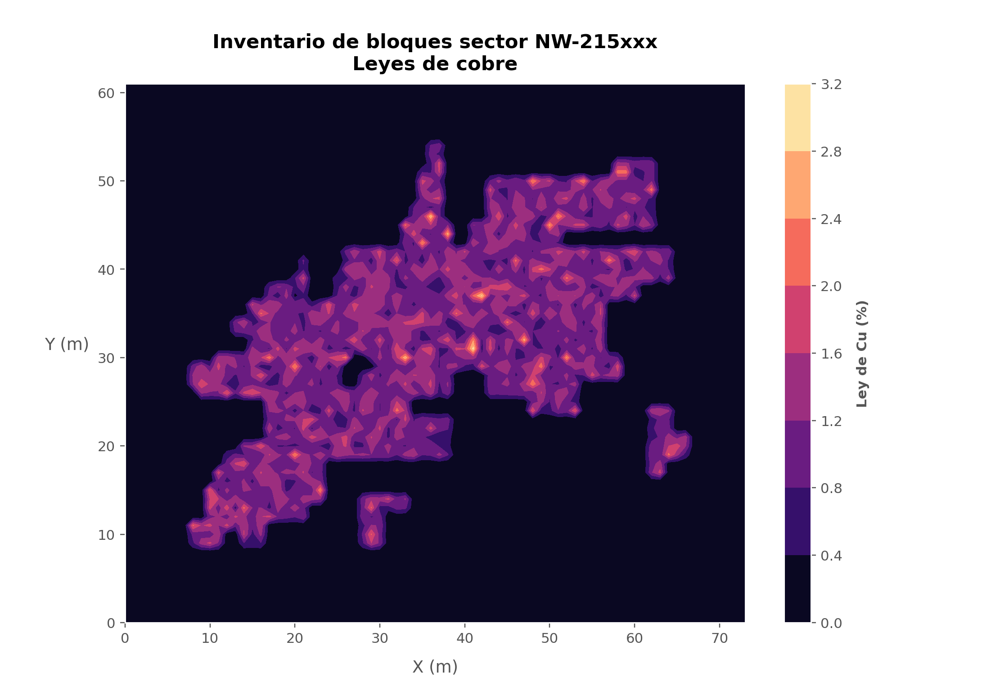

<IPython.core.display.Javascript object>


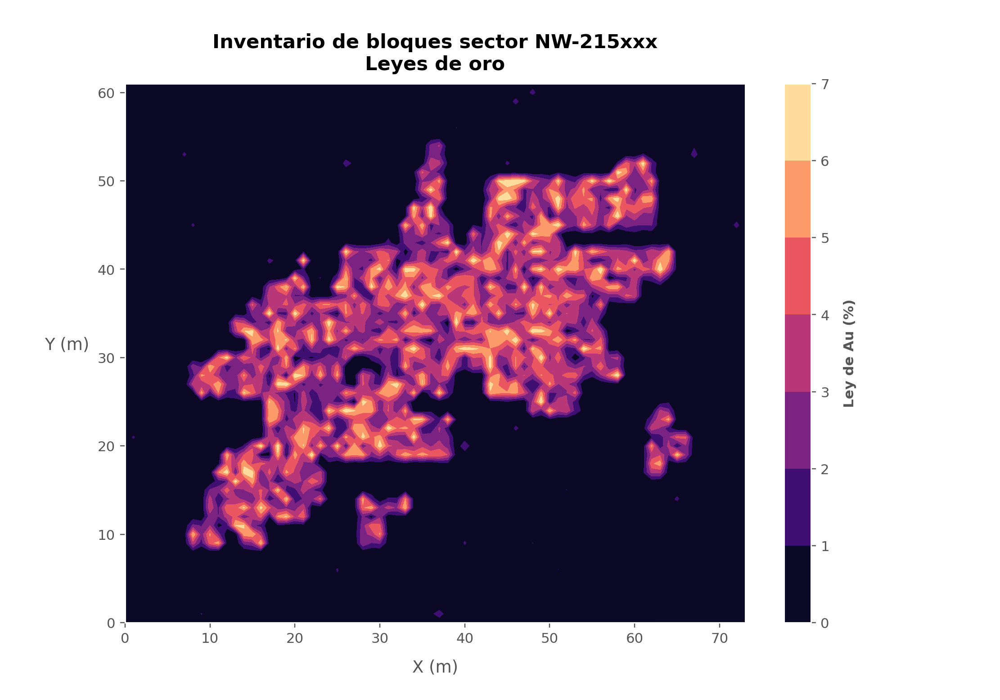

In [29]:
# Visualización rápida de estos inventarios de bloques mediante un histograma.
fig, ax = plt.subplots(figsize=(10, 7))
p = ax.contourf(blocks_cu.values, cmap="magma")
ax.set_xlabel("X (m)", fontsize=12, labelpad=10)
ax.set_ylabel("Y (m)", fontsize=12, labelpad=22, rotation=0)
ax.set_title(
    "Inventario de bloques sector NW-215xxx\nLeyes de cobre", 
    fontsize=14, fontweight="bold", pad=10
)
cb = plt.colorbar(p)
cb.set_label("Ley de Cu (%)", fontsize=10, fontweight="bold", labelpad=10);

fig, ax = plt.subplots(figsize=(10, 7))
p = ax.contourf(blocks_au.values, cmap="magma")
ax.set_xlabel("X (m)", fontsize=12, labelpad=10)
ax.set_ylabel("Y (m)", fontsize=12, labelpad=22, rotation=0)
ax.set_title(
    "Inventario de bloques sector NW-215xxx\nLeyes de oro", 
    fontsize=14, fontweight="bold", pad=10
)
cb = plt.colorbar(p)
cb.set_label("Ley de Au (%)", fontsize=10, fontweight="bold", labelpad=10);

La visualización de las leyes justifica, al menos en términos visuales, el hecho de que el oro sea un producto secundario de esta operación.

Necesitamos ahora determinar el inventario de cobre equivalente de este sector. Decimos cobre equivalente (y no oro equivalente) debido a que, en un principio, se ha establecido que el cobre es el producto principal a explotar, y el oro un subproducto. Para determinar el cobre equivalente, se debe utilizar un factor de conversión para el oro a fin de expresarlo en unidades de cobre, llamado **factor de equivalencia**, definido como $F_{eq}=\frac{R_{s}P_{s}}{R_{p}P_{p}}$, donde ${R_s}$ es la recuperación metalúrgica asociada para el subproducto (en este caso, el oro), ${P_s}$ es el precio del subproducto de interés en el mercado (nuevamente, el oro), ${R_p}$ es la recuperación metalúrgica estimada para el producto principal (en este caso, el cobre), y ${P_p}$ es el precio del producto principal de interés en el mercado (otra vez, el cobre).

Cada factor de equivalencia debe calcularse considerando las mismas unidades de precio y recuperación. Esto se cumple, conforme el enunciado del problema, para la recuperación, pero no para el precio. Por lo tanto, calcularemos los precios respectivos de cada metal, en US$/t, a fin de usar las mismas unidades en cada caso. Para ello, consideraremos que 1 t = 2204 lb = 35274 oz. Así:

In [30]:
# Construimos un diccionario para alojar ahí los parámetros de entrada de nuestro problema.
params = {
    "cu_price": 3.8,
    "au_price": 1850,
    "cu_recov": 85,
    "au_recov": 78,
    "costs":{
        "mine": 3.2,
        "plant": 12.8,
        "waste": 0.92,
        "sell" : 1.00
    },
    "d_rate": 0.16
}

In [31]:
# Y ahora calculamos los precios en US$/t.
cu_price_corr = params["cu_price"] * 2204
au_price_corr = params["au_price"] * 35274

# Y el factor de equivalencia.
eq_factor = (params["au_recov"] * au_price_corr) / (params["cu_recov"] * cu_price_corr)

Ahora calculamos el inventario equivalente de cobre. Recordemos que, para ello, las leyes de ambos minerales deben estar en las mismas unidades (en este caso, usaremos las unidades de cobre). Por ello, la ley de Au se dividirá por 10000 (que es la proporción que hay entre una parte por cien y una parte por millón). En otras palabras: 1 % = 10000 gpt:

In [32]:
blocks_cu_eq = pd.DataFrame(
    data=blocks_cu.values + (blocks_au.values/10000)*eq_factor,
    index=[f"CuEq_{j}" for j in range(1, len(blocks_cu)+1)],
    columns=blocks_cu.columns
)

Por un tema netamente ilustrativo, podemos visualizar la distrbución resultante de Cu equivalente:

<IPython.core.display.Javascript object>


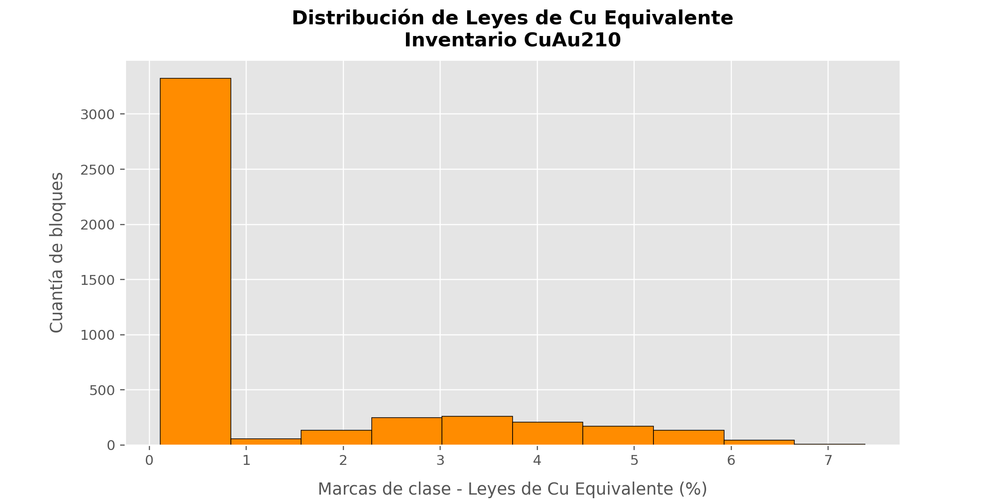

In [33]:
# Histogramas de leyes de cobre equivalente.
fig, ax = plt.subplots(figsize=(10, 5))
ax.hist(
    np.ravel(blocks_cu_eq.values), bins=10, edgecolor="k", 
    color="darkorange", label="Ley de Cu Eq (%)"
)
ax.set_title(
    "Distribución de Leyes de Cu Equivalente\nInventario CuAu210", 
    fontsize=14, fontweight="bold", pad=10
)
ax.set_ylabel("Cuantía de bloques", fontsize=12, labelpad=10)
ax.set_xlabel("Marcas de clase - Leyes de Cu Equivalente (%)", fontsize=12, labelpad=10);

Ahora construiremos las curvas de tonelaje vs ley para los tres casos descritos previamente. Para ello, debemos utilizar la información relativa a la geometría de los bloques de este inventario. Por lo tanto, pasaremos la tabla suministrada en el enunciado a un formato de diccionario de Python:

In [34]:
geom_params = {"dx": 25, "dy": 25, "dz": 20, "density": 2.8}

Calculamos el tonelaje completo asociado a este inventario:

In [35]:
# Masa de un bloque.
block_mass = geom_params["dx"] * geom_params["dy"] * geom_params["dz"] * geom_params["density"]

# Cuantía total de bloques.
n_blocks = blocks_cu_eq.shape[0] * blocks_cu_eq.shape[1]

# Masa total del inventario (en Mt).
total_mass = block_mass * n_blocks / 1000000

Ahora debemos construir las tablas requeridas para el gráfico de tonelaje versus ley. Primero ilustraremos en detalle el caso de la curva de leyes de Cu:

In [36]:
# Como las leyes de Cu se distribuyen entre 0% y 3%, distribuiremos los intervalos de clase utilizando
# estos mismos valores.
min_cu_grade = np.round(np.linspace(0, 2.7, 20), 2)
max_cu_grade = np.concatenate([min_cu_grade[1:], np.array([3.0])])
class_mark_cu = np.round(
    np.linspace((min_cu_grade[0] + max_cu_grade[0])/2, (min_cu_grade[-1] + max_cu_grade[-1])/2, 20), 2
)

In [37]:
# Las leyes anteriores constituyen intervalos de clase y su respectiva marca de clase para las 
# leyes de cobre. De lo anterior, las pasaremos a un formato de dataframe para así trabajar 
# rápidamente con ellas.
cu_table = pd.DataFrame(
    data=np.column_stack([min_cu_grade, class_mark_cu, max_cu_grade]),
    columns=["Menor (%)", "Clase (%)", "Mayor (%)"]
)

In [38]:
# Y ahora calculamos las frecuencias respectivas. Para ello, primero definimos una versión 
# "aplanada" de nuestro inventario de cobre, a fin de facilitar nuestro trabajo.
blocks_cu_flat = np.ravel(blocks_cu)

# Creamos la columna de frecuencias en nuestro dataframe.
cu_table["Frecuencia"] = 0

# Y calculamos las frecuencias rápidamente.
freqs = np.histogram(blocks_cu_flat, bins=20)[0]

# Asignándolas a la tabla de frecuencias.
cu_table["Frecuencia"] = freqs

Para comprobar que hemos hecho correctamente el cálculo, basta con verificar que la suma de todas las frecuencias es igual a la suma de todos los bloques del inventario.

In [39]:
freqs.sum() == blocks_cu.size

True

Ahora debemos calcular las frecuencias porcentuales de cada intervalo de leyes:

In [40]:
cu_table["Porcentaje (%)"] = 0

for j in range(len(cu_table)):
    cu_table.loc[j, "Porcentaje (%)"] = cu_table.loc[j, "Frecuencia"] / cu_table["Frecuencia"].sum()

Y luego, el porcentaje acumulado asociado a cada intervalo de leyes:

In [41]:
cu_table["Porcentaje acumulado (%)"] = cu_table["Porcentaje (%)"].cumsum()

A continuación, la masa de material asociado a cada intervalo de leyes:

In [42]:
cu_table["Tonelaje (Mt)"] = cu_table["Porcentaje (%)"] * total_mass

Y la masa acumulada de mineral para cada intervalo:

In [43]:
for j in range(len(cu_table)):
    if j == 0:
        cu_table.loc[j, "Mineral (Mt)"] = cu_table["Tonelaje (Mt)"].sum()
    else:
        cu_table.loc[j, "Mineral (Mt)"] =\
            cu_table.loc[j-1, "Mineral (Mt)"] - cu_table.loc[j-1, "Tonelaje (Mt)"]

Luego, calculamos las leyes medias de mineral para cada subconjunto de bloques. Para ello, primero, creamos la columna respectiva, y luego calculamos las leyes medias por intervalos mediante un loop sencillo:

In [44]:
for j in range(len(cu_table)):
    queried_blocks = blocks_cu_flat[
        (blocks_cu_flat > cu_table.loc[j, "Menor (%)"]) & (blocks_cu_flat <= cu_table.loc[j, "Mayor (%)"])
    ]
    avg_j = queried_blocks.mean()
    cu_table.loc[j, "Ley media (%)"] = avg_j

Ya solo nos queda calcular las razones estéril-mineral por intervalo. Para ello, primero generamos una columna para calcular el estéril acumulado por intervalo:

In [45]:
cu_table["Esteril acumulado (Mt)"] = 0

Luego generamos el cálculo mediante un loop:

In [46]:
for j in range(len(cu_table)):
    if j == 0:
        cu_table.loc[j, "Esteril acumulado (Mt)"] = 0.0
    elif j == 1:
        cu_table.loc[j, "Esteril acumulado (Mt)"] = cu_table.loc[j-1, "Tonelaje (Mt)"]
    else:
        cu_table.loc[j, "Esteril acumulado (Mt)"] =\
            cu_table.loc[j-1, "Esteril acumulado (Mt)"] + cu_table.loc[j-1, "Tonelaje (Mt)"]

Finalmente, calculamos la razón estéril-mineral (REM):

In [47]:
cu_table["RLM"] = cu_table["Esteril acumulado (Mt)"] / cu_table["Mineral (Mt)"]

El resultado de los cálculos anteriores es la siguiente **tabla de tonelaje versus ley** para las leyes de cobre:

In [48]:
cu_table

,Menor (%),Clase (%),Mayor (%),Frecuencia,Porcentaje (%),Porcentaje acumulado (%),Tonelaje (Mt),Mineral (Mt),Ley media (%),Esteril acumulado (Mt),RLM
0,0.00,0.07,0.14,3343,0.728640,0.728640,117.005,160.580,0.100619,0.000,0.000000
1,0.14,0.22,0.28,1,0.000218,0.728858,0.035,43.575,0.250000,117.005,2.685141
2,0.28,0.36,0.43,9,0.001962,0.730820,0.315,43.540,0.427076,117.040,2.688103
3,0.43,0.51,0.57,56,0.012206,0.743025,1.960,43.225,0.523667,117.355,2.714980
4,0.57,0.66,0.71,146,0.031822,0.774847,5.110,41.265,0.648726,119.315,2.891433
5,0.71,0.80,0.85,184,0.040105,0.814952,6.440,36.155,0.784478,124.425,3.441433
6,0.85,0.95,0.99,177,0.038579,0.853531,6.195,29.715,0.918900,130.865,4.404005
7,0.99,1.09,1.14,171,0.037271,0.890802,5.985,23.520,1.061028,137.060,5.827381
8,1.14,1.24,1.28,161,0.035092,0.925894,5.635,17.535,1.205620,143.045,8.157685
9,1.28,1.39,1.42,115,0.025065,0.950959,4.025,11.900,1.347135,148.680,12.494118


Ya sólo nos resta construir la curva de tonelaje versus ley para el caso del cobre:

<IPython.core.display.Javascript object>


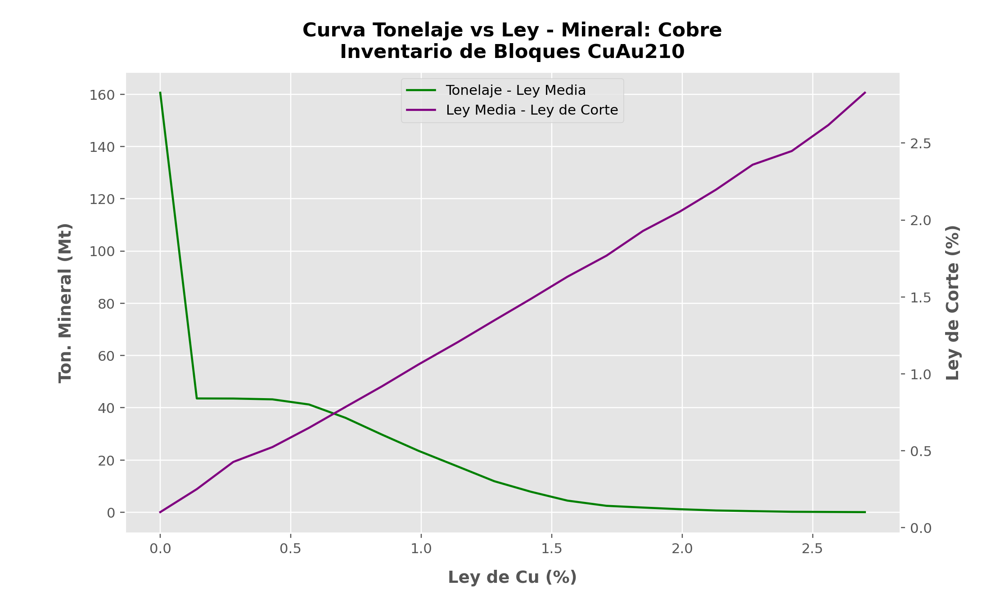

In [49]:
fig, ax = plt.subplots(figsize=(10, 6))
ax1 = ax.twinx()
p1 = ax.plot(
    cu_table["Menor (%)"], cu_table["Mineral (Mt)"], color="green", label="Tonelaje - Ley Media"
)
p2 = ax1.plot(
    cu_table["Menor (%)"], cu_table["Ley media (%)"], color="purple", label="Ley Media - Ley de Corte"
)
ax1.grid(False)
ax.set_xlabel("Ley de Cu (%)", fontsize=12, fontweight="bold", labelpad=10)
ax.set_ylabel("Ton. Mineral (Mt)", fontsize=12, fontweight="bold", labelpad=10)
ax1.set_ylabel("Ley de Corte (%)", fontsize=12, fontweight="bold", labelpad=10)
p = p1 + p2
labels = [l.get_label() for l in p]
ax.legend(p, labels, loc="upper center")
ax.set_title(
    "Curva Tonelaje vs Ley - Mineral: Cobre\nInventario de Bloques CuAu210", 
    fontsize=14, fontweight="bold", pad=10
);

Lo que resuelve el problema de calcular esta curva para el caso únicamente d elas leyes de cobre. El caso del cobre equivalente se deja como ejercicio al lector. ◼︎

## Personalización de barras de color.

### Aspectos relativos a la elección de un mapa de colores.
Como ya hemos visto varias veces en esta asignatura, los mapas de colores, cuando son utilizados por un determinado tipo de gráfico, suelen ser implementados por medio del parámetro `cmap`. Para referenciar el significado de dicho mapa de colores, solemos usar la función `plt.colorbar()` para construir una barra que especifique el significado de cada color conforme el valor de la variable asignada al mapa completo.

Consideremos el siguiente ejemplo, en el cual haremos uso del método `imshow()`, y que permite graficar imágenes conforme un mapa de colores determinado. Las imágenes, como bien sabemos, no son más que arreglos de Numpy cuyos elementos representan ciertas intensidades de pixel y colores en un determinado canal:

In [50]:
# Definimos una secuencia de valores para crear el gráfico.
x = np.linspace(start=0, stop=20, num=1000)
y = np.cos(x)*np.sin(x.reshape(-1, 1))

<IPython.core.display.Javascript object>


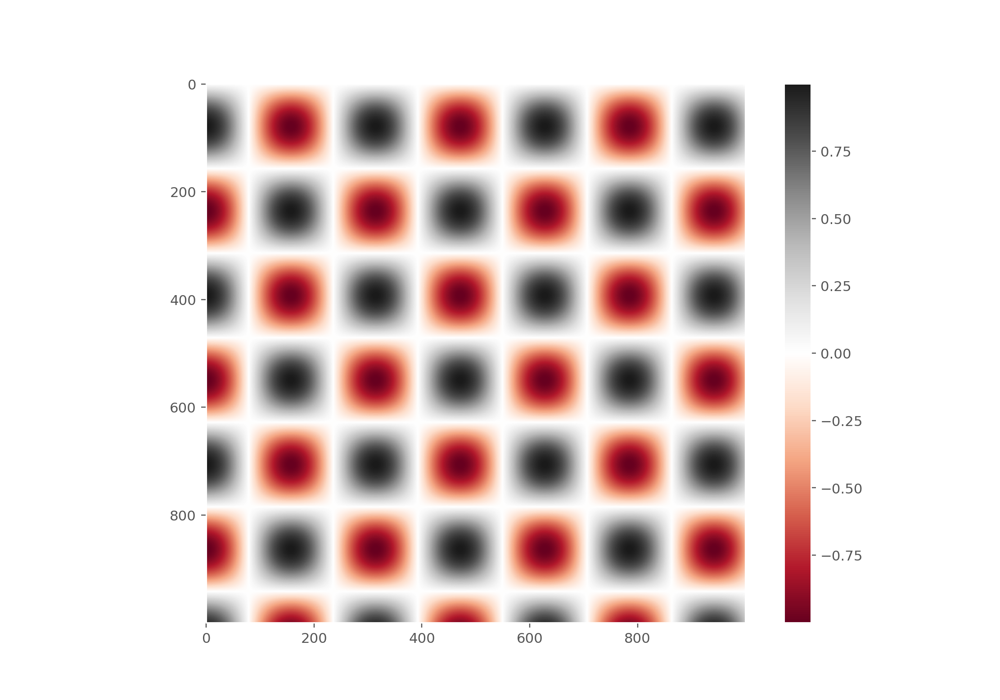

In [51]:
# Creamos el gráfico.
fig, ax = plt.subplots(figsize=(10, 7))
p = ax.imshow(y, cmap="RdGy")
ax.grid(False)
cb = plt.colorbar(p);

El color es un aspecto fundamental en la visión de los seres humanos y, por supuesto, resulta importante en el diseño de cualquier figura. Por esa razón, su elección resulta fundamental. Si existen elementos importantes en un gráfico, podemos usar colores para poder destacarlos. Sin embargo, es muy justo preguntarnos si efectivamente es necesario darle uso al color en un gráfico y no simplemente hacer uso únicamente de una escala de grises. Aquello resulta evidente si el gráfico anterior se expresa en dicha escala:

<IPython.core.display.Javascript object>


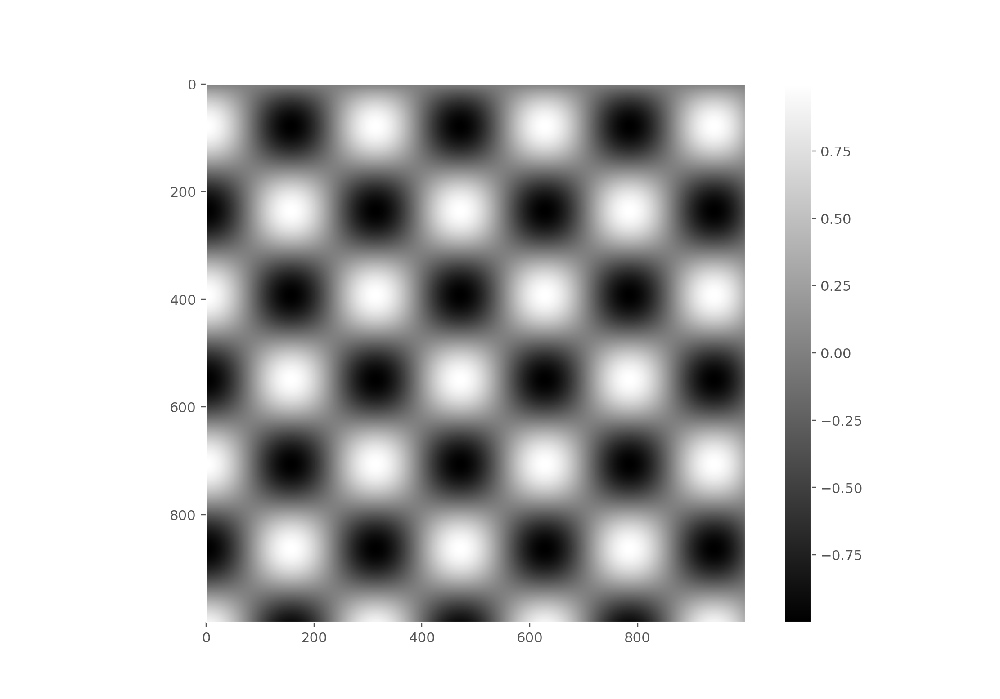

In [52]:
# Mismo gráfico anterior, pero en escala de grises. 
fig, ax = plt.subplots(figsize=(10, 7))
p = ax.imshow(y, cmap="gray")
ax.grid(False)
cb = plt.colorbar(p);

Vemos que el gráfico nos permite la visualización de una función multimodal; es decir, con una cantidad enorme (posiblemente infinita) de máximos y mínimos locales. Por lo tanto, el color debe ser escogido de tal forma que podamos diferenciar de manera clara y *natural* donde están, en el gráfico, tales máximos y mínimos. El mapa de color `RdGy` cumple con ese propósito a la perfección, porque nos permite asociar inmediatamente los mínimos locales al color rojo, y los máximos locales al color negro. Cualquier mapa de color de tipo divergente, con extremos bien diferenciados y una combinación de dos colores con el blanco en la frontera de ambos, puede cumplir pefectamente con esta tarea, ya que observamos que la data está centrada con respecto a un valor medio. El mapa de color `gray` también nos permite diferenciar máximos y mínimos locales, pero con mayor dificultad.

Existen fundamentalmente tres tipos de mapas de color:

- **Mapas de color secuenciales:** Que están conformados por una secuencia continua de colores (por ejemplo, `viridis` o `binary`).
- **Mapas de color divergentes:** Usualmente contienen dos colores distintivos, y permiten mostrar desviaciones positivas o negativas con respecto a un valor medio (por ejemplo, `RdGy` o `PuOr`).
- **Mapas de color cualitativos:** Mezclan colores que no siguen una secuencia uniforme de frecuencias (por ejemplo, `rainbow` o `cubehelix`).

El mapa de color `jet`, que es la opción por defecto en versiones de **Matplotlib** anteriores a la 2.0, es un ejemplo de mapa cualitativo. Su estado como opción por defecto fue desafortunada en su tiempo, porque los mapas cualitativos generalmente son opciones muy pobres para representar variaciones de variables continuas. Entre estos problemas, se considera además el hecho de que estos mapas de color usualmente no muestran ninguna progresión de tipo uniforme a medida de que aumenta el brillo en la escala de color. Podemos ver esto convirtiendo el mapa de color `jet` a su respectiva escala de grises:

In [53]:
from matplotlib.colors import LinearSegmentedColormap

In [54]:
# Construimos una función para transformar cualquier mapa de color de Matplotlib en su
# misma versión, pero en escala de grises.
def grayscale_cmap(cmap):
    """
    Función que retorna una versión en escala de grises de un mapa de color dado
    """
    cmap = plt.cm.get_cmap(cmap)
    colors = cmap(np.arange(cmap.N))
    
    # Convertimos un modelo RGBA a una escala perceptiva de grises con luminancia definida
    RGB_weight = [0.299, 0.587, 0.114]
    luminance = np.sqrt(np.dot(colors[:, :3] ** 2, RGB_weight))
    colors[:, :3] = luminance.reshape(-1, 1)
        
    return LinearSegmentedColormap.from_list(cmap.name + "_gray", colors, cmap.N)

In [55]:
# Función que nos permite visualizar cualquier mapa de color de Matplotlib.
def view_colormap(cmap):
    """
    Función que grafica un mapa de color con su equivalente en escala de grises
    """
    cmap = plt.cm.get_cmap(cmap)
    colors = cmap(np.arange(cmap.N))
    
    cmap = grayscale_cmap(cmap)
    grayscale = cmap(np.arange(cmap.N))
    
    fig, ax = plt.subplots(2, figsize=(6, 2), subplot_kw=dict(xticks=[], yticks=[]))
    ax[0].imshow([colors], extent=[0, 10, 0, 1])
    ax[1].imshow([grayscale], extent=[0, 10, 0, 1])

<IPython.core.display.Javascript object>


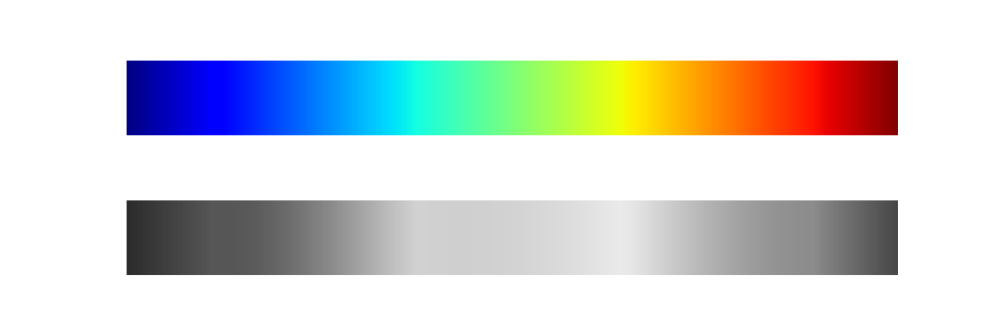

In [56]:
# Transformamos el mapa de color "jet" a su versión escala de grises.
view_colormap('jet')

Notemos las líneas brillantes en el mapa de color en escala de grises. Incluso a todo color, este brillo no uniforme significa que el ojo verá atraída su atención a ciertas porciones del rango de color, lo que hará énfasis, potencialmente, en partes no importantes del conjunto de datos respectivo. Es mejor, en este caso, un mapa de color como `viridis` (opción por defecto en **Matplotlib** desde su versión 2.0), el cual está construido especialmente por su crecimiento uniforme de brillo a lo largo de su rango de colores:

<IPython.core.display.Javascript object>


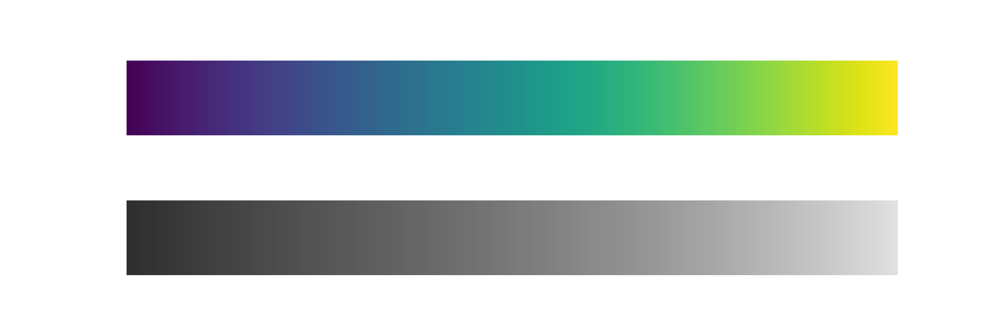

In [57]:
# Transformamos el mapa de color "viridis" a su versión escala de grises.
view_colormap('viridis')

Para otras situaciones, tales como aquellas en las que deseamos mostrar desviaciones positivas y negativas de una media, mapas de color duales como `RdGy` pueden ser muy útiles. Sin embargo, podemos notar que, en una transformación a escala de grises, dicha información se pierde:

<IPython.core.display.Javascript object>


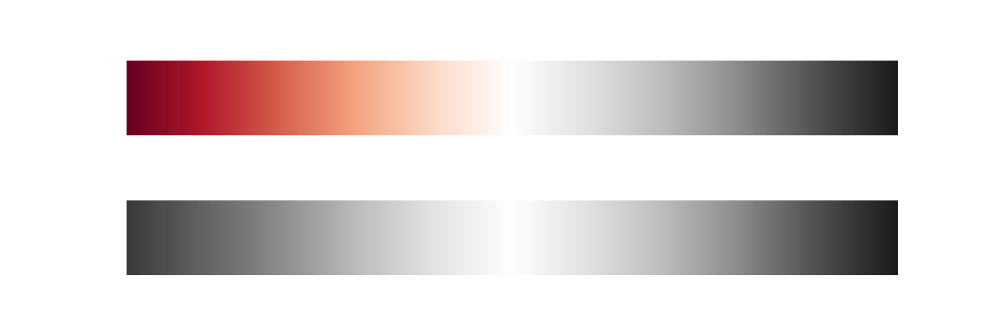

In [58]:
# Transformamos el mapa de color "RdGy" a su versión escala de grises.
view_colormap('RdGy')

### Límites de color y extensiones.
**Matplotlib** nos provee de un amplio rango de alternativas para la personalización de barras de colores. La barra de color misma es una instancia de un objeto de tipo `plt.Axes`, por lo que todos los métodos de formateo de ejes y rótulos que hemos visto previamente son aplicables aquí. La barra de color como tal posee una flexibilidad interesante: Por ejemplo, podemos fijar los límites de color e indicar los colores fuera de los límites de la barra que queremos mostrar mediante símbolos triangulares al extremo de las barras mediante la propiedad `extend`. Esto podría ser muy útil para graficar data con ruido significativo:

In [59]:
# Generamos ruido en el 1% de los pixeles de la imagen
added_noise = (rng.random(y.shape) < 0.01)
y[added_noise] = rng.normal(0, 3, np.count_nonzero(added_noise))

<IPython.core.display.Javascript object>


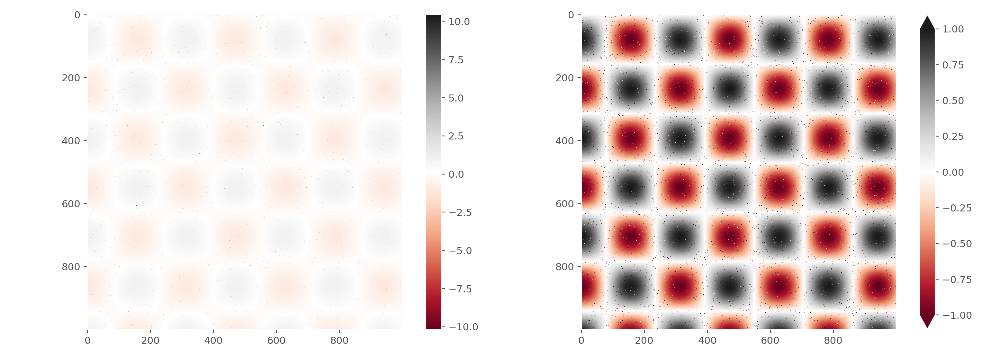

In [60]:
# Graficamos la imagen anterior, pero con el ruido añadido.
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.imshow(y, cmap='RdGy')
plt.colorbar()
plt.grid(False)

plt.subplot(1, 2, 2)
plt.imshow(y, cmap='RdGy')
plt.colorbar(extend='both')
plt.grid(False)
plt.clim(-1, 1)
plt.tight_layout();

Notemos que, en el panel del lado izquierdo, los límites de color por defecto responden al hecho de que los pixeles con ruido tienen valores muy extremos, por lo que el rango de valores (colores) que es de nuestro interés de ve completamente distorsionado por tales variaciones extremas. En el panel del lado derecho, seteamos los límites de color manualmente (mediante la función `plt.clim()`), y añadimos extensiones para indicar que existen valores fuera de estos límites. El resultado es, por lo tanto, más claro.

### Barras de color discretas.
Los mapas de color son, por defecto, continuos, pero con frecuencia tenemos la necesidad de representar valores de tipo discreto (típicos de variables categóricas). La forma más sencilla de hacer esto es mediante la función `plt.get_cmap()`, y pasar el nombre de un mapa de color determinado, junto con el número de intervalos de variación deseados.

Por cierto, toda función que acepte el parámetro `cmap` para definir un mapa de color, también acepta los parámetros `vmin` y `vmax` para definir los límites del rango de valores a mapear. Esto es equivalente al uso de la función `plt.clim()`, en caso de estar trabajando mediante la interfaz de **Matplotlib** orientada a objetos:

<IPython.core.display.Javascript object>


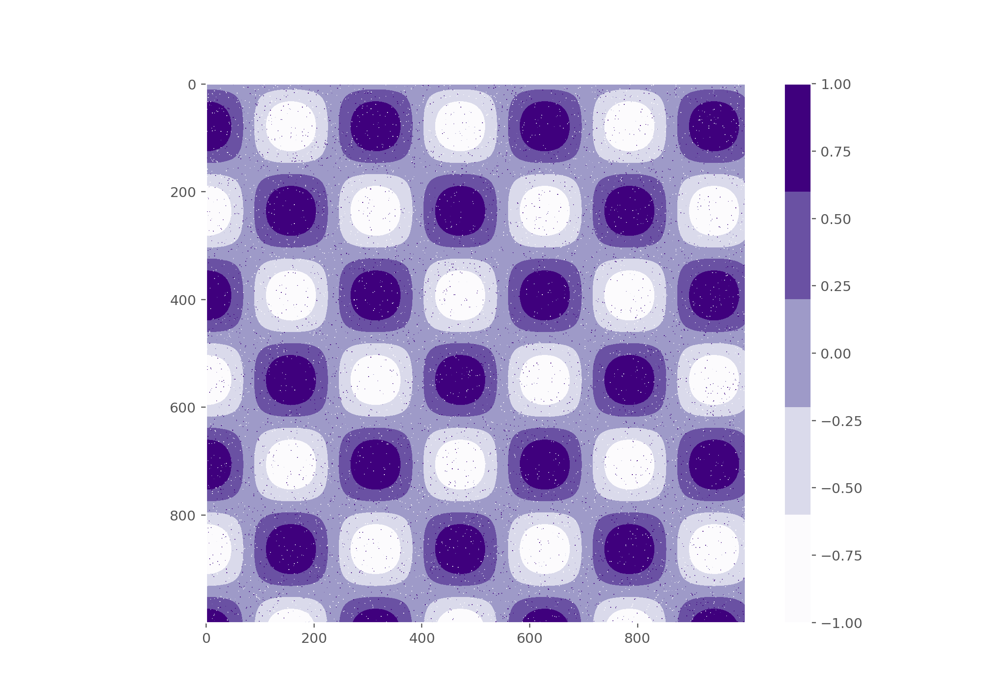

In [61]:
fig, ax = plt.subplots(figsize=(10, 7))
p = ax.imshow(y, cmap=plt.cm.get_cmap('Purples', 5), vmin=-1, vmax=1)
ax.grid(False)
cb = plt.colorbar(p);

## Paneles de gráficos.
A veces, es muy útil comparar diferentes visualizaciones de nuestra data de un lado a otro. Para este concepto, **Matplotlib** trabaja con el ideal de paneles de gráficos (o, literalmente, subgráficos o *subplots*): Grupos de gráficos más pequeños que conviven en una única figura. Estos *subplots* pueden ser incrustaciones, grillas o mallas más complejas. A continuación, exploraremos algunas rutinas sencillas para entender como crear estos objetos.

### Subplots manuales.
El método más básico para crear subplots es mediante la función `plt.axes()`. Como hemos visto previamente, por defecto, dicha función crea un objeto de tipo `Axes` que llena la figura completamente. Dicha función también puede tomar un argumento opcional que es una lista de cuatro números en el sistema coordenado que conforma tal figura. Estos números representan los valores `[izquierda, fondo, ancho, altura]` en dicho sistema coordenado, y varían de 0 en el sector inferior izquierdo de la figura, a 1 en el sector superior derecho.

Por ejemplo, podemos crear un eje incrustado en la región superior derecha de otro eje, seteando las posiciones x e y en 0.65 (esto es, partiendo en el 65% del ancho y de la altura de la figura original, respectivamente), y seteando su tamaño en 0.2 (es decir, un 20% de la figura original):

/var/folders/sn/hlgjzv2n1537dplx8bvvj1c80000gn/T/ipykernel_56211/3466285032.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10, 5))


<IPython.core.display.Javascript object>


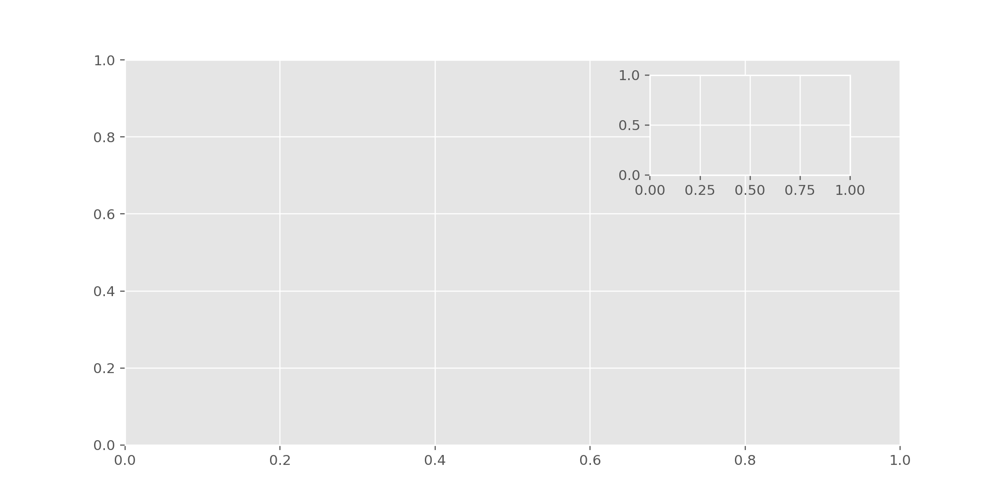

In [62]:
# Primer intento de incrustación.
fig = plt.figure(figsize=(10, 5))
ax1 = plt.axes()  # Eje estándar
ax2 = plt.axes([0.65, 0.65, 0.2, 0.2]);

El equivalente de la función `plt.axes()` en la interfaz orientada a objetos es el método `fig.add_axes()`, que como vemos se aplica directamente sobre la figura que hemos creado por medio de la figura `plt.figure()`. Usemos esto para crear dos ejes verticalmente apilados:

<IPython.core.display.Javascript object>


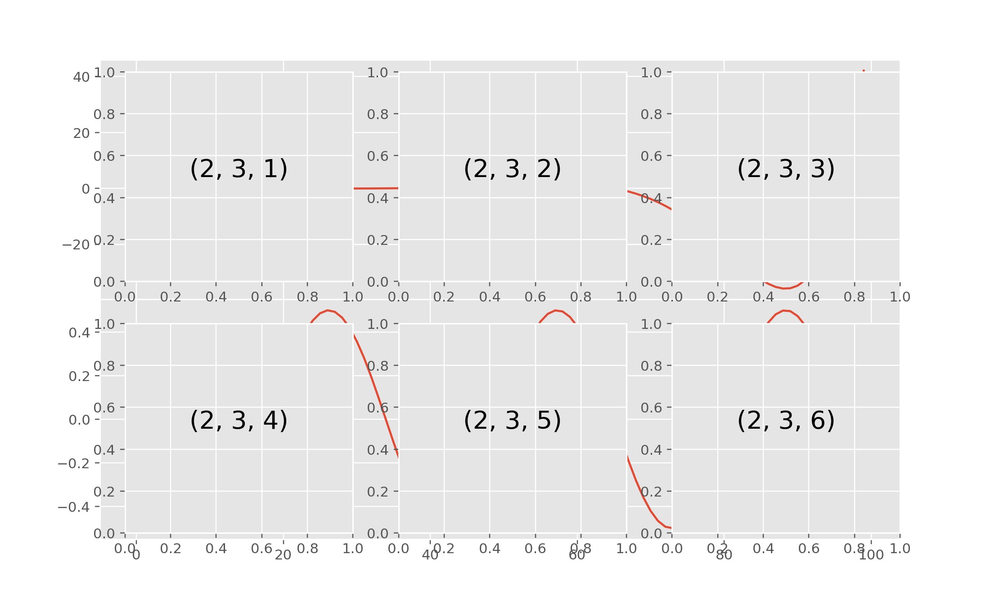

In [63]:
# Creamos los paneles del gráfico (uno superior y uno inferior).
fig = plt.figure(figsize=(10, 6))
ax1 = fig.add_axes([0.1, 0.5, 0.8, 0.4], xticklabels=[])
ax2 = fig.add_axes([0.1, 0.1, 0.8, 0.4])

# Rellenamos cada panel con un gráfico.
x = np.linspace(start=-5, stop=5, num=100)
ax1.plot(np.exp(x)*np.cos(x))
ax2.plot(np.sin(x)*np.cos(x));

Ahora tenemos dos paneles (el superior sin marcas de graduación en su eje horizontal, lo que hemos definido mediante el uso del parámetro `xticklabels`, asignándole una lista vacía) que son tangentes los unos con los otros: El fondo del panel superior (en la posición `0.5`) coincide con el inicio del panel inferior (en la posición `0.1 + 0.4`).

### Grillas automáticas.
Un conjunto de gráficos alineados horizontal o verticalmente constituye una necesidad muy común en **Matplotlib**, por lo que existen rutinas que permiten su creación de manera muy sencilla. La más básica de estas rutinas es `plt.subplot()` (que ya la habíamos usado previamente, aunque sin entrar en mayores detalles), la que permite crear un único panel en una grilla. Como se observa en el siguiente bloque de código, esta función acepta tres argumentos enteros: El número de filas de la grilla, el número de columnas, y el índice del gráfico que se creará dentro de la grilla, cuyo orden es de izquierda a derecha, y de arriba hacia abajo:

<IPython.core.display.Javascript object>


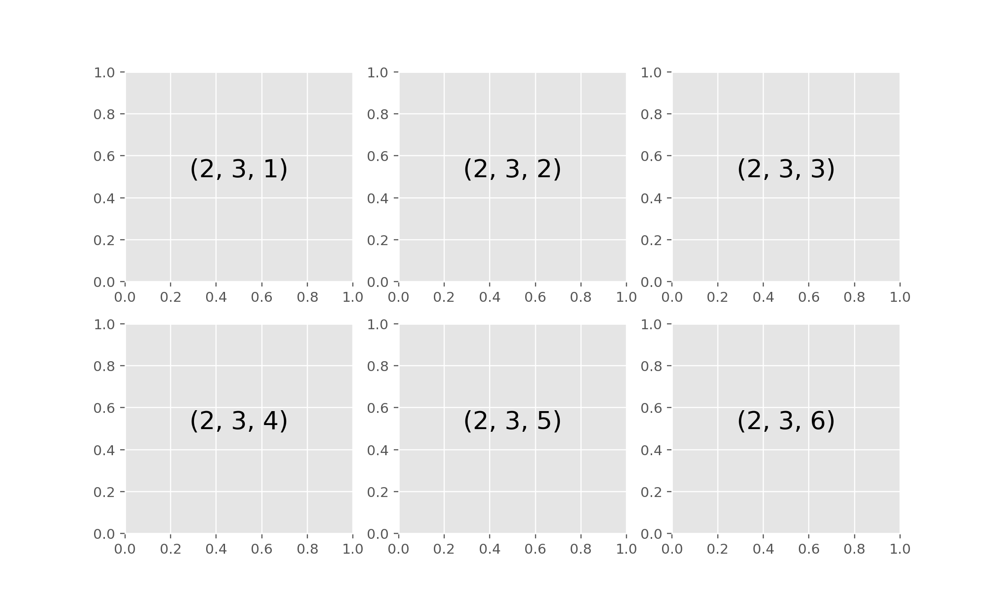

In [64]:
# Creación de una grilla completa.
plt.figure(figsize=(10, 6))
for i in range(1, 7):
    plt.subplot(2, 3, i)
    plt.text(0.5, 0.5, str((2, 3, i)), fontsize=18, ha='center')

En el loop anterior hemos usado la función `plt.text()` para generar el texto que caracteriza los valores que toman los argumentos de la función `plt.subplot()` con respecto a las posiciones de los paneles en esta grilla. Ya profundizaremos en la creación de texto y anotaciones más adelante.

Observemos que la figura anterior presenta varios problemas relativos al posicionamiento de las marcas de graduación en cada panel, ya que tienden a superponerse y *estorbarse* entre sí. La función `plt.subplots_adjust()` puede ser utilizada para ajustar el espacio entre los gráficos que constituyen una grilla y evitar inconvenientes como el anterior. Si deseamos construir una grilla como la anterior por medio del uso de la interfaz orientada a objetos de **Matplotlib**, aplicando en este caso el método `subplots_adjust()` sobre la figura propiamente tal para construir una grilla sin superposición de marcas de graduación, podemos escribir:

<IPython.core.display.Javascript object>


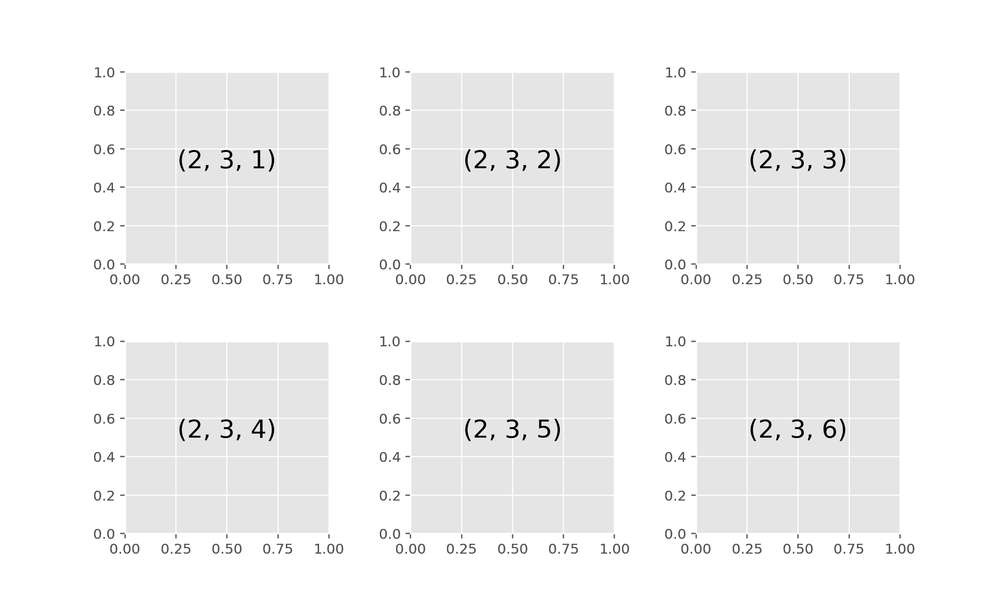

In [67]:
# Mismo caso anterior, orientado a objetos y bien ajustado.
fig.subplots_adjust(hspace=0.4, wspace=0.4)
for i in range(1, 7):
    ax = fig.add_subplot(2, 3, i)
    ax.text(0.5, 0.5, str((2, 3, i)), fontsize=18, ha='center')
fig

Los parámetros `hspace` y `wspace` regulan el espaciamiento vertical y horizontal, respectivamente, en unidades de la correspondiente dimensión del respectivo panel (en nuestro caso, 40% en ambas dimensiones).

### Grillas instantáneas.
La técnica descrita previamente para la generación de gráficos en grillas puede llegar a ser un tanto tediosa. Especialmente si queremos ocultar los rótulos de los ejes X e Y en los sub-gráficos interiores. En este caso, la función `plt.subplots()` es la herramienta más sencilla de utilizar. En vez de crear un único sub-gráfico, esta función genera una grilla completa de ellos en una única línea, retornándolos en uà estructura construida sobre un arreglo de **Numpy**. Los argumentos de esta función corresponden al número de filas y el número de columnas de la grilla de gráficos (`nrow` y `ncol`, respectivamente), con algunos argumentos adicionales, como `sharex` y `sharey`, los cuales nos permiten especificar las relaciones que tendrán los ejes de cada gráfico (puntualmente, su compartirán los ejes X e Y entre ellos).

En el siguiente bloque de código, crearemos una grilla de 2x3 paneles, donde cada elemento en la misma fila comparte su eje Y, y cada elemento en la misma columna comparte su eje X:

<IPython.core.display.Javascript object>


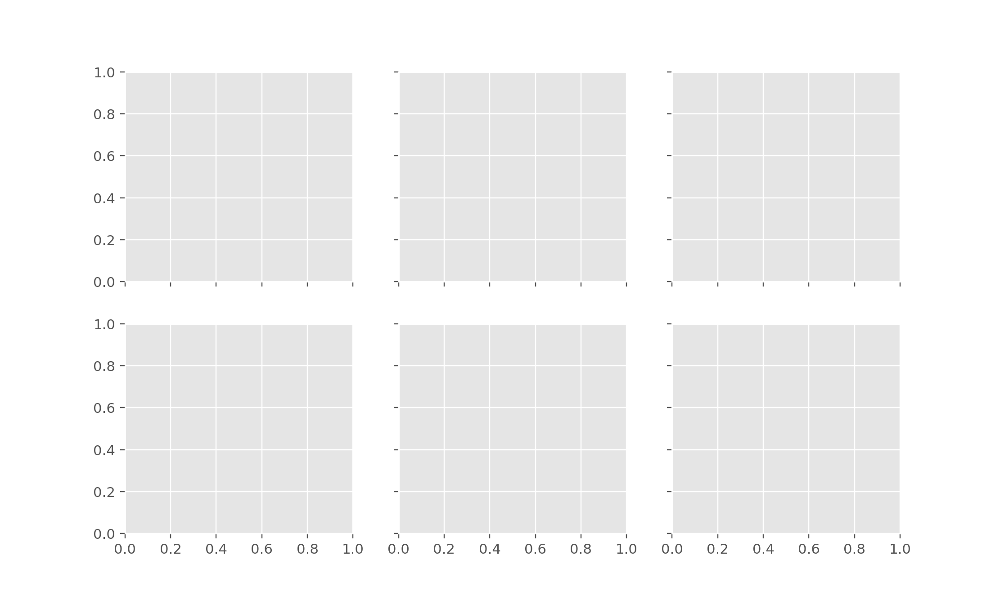

In [68]:
# Grilla instantánea.
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(10, 6), sharex=True, sharey=True)

Notemos que, al especificar los parámetros `sharex` y `sharey`, hemos removido automáticamente los rótulos de eje de los gráficos interiores, logrando que la grilla se vea mucho más limpia. La grilla resultante de objetos tipo `Axes` se retorna en un arreglo de **Numpy**, lo que permite una especificación conveniente de los subgáficos mediante una notación indexada:

<IPython.core.display.Javascript object>


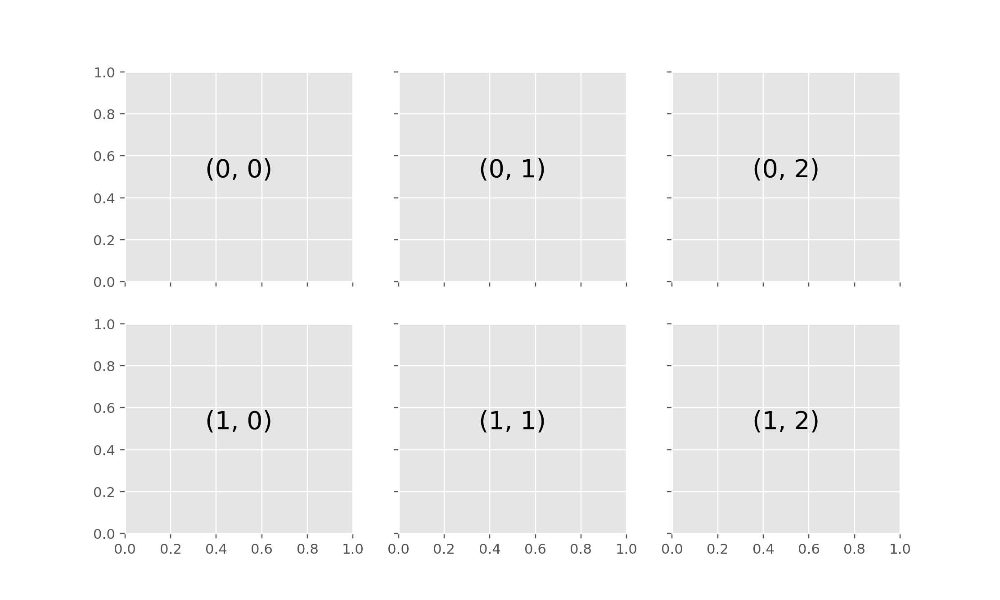

In [69]:
# Objetos tipo Axes en un arreglo bidimensional, indexados de  forma tal que la posición 
# de cada sub-gráfico es del tipo [fila, columna] en la grilla.
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(10, 6), sharex=True, sharey=True)
for i in range(2):
    for j in range(3):
        ax[i, j].text(0.5, 0.5, str((i, j)), fontsize=18, ha='center')

Es claro que esta forma de construir grillas de gráficos es más intuitiva y escalable que la realizada previamente con la función `plt.subplot()`.

Es posible construir grillas no regulares; es decir, cuyos paneles no sean todos del mismo tamaño. Para ello, podemos recurrir a la clase `plt.Gridspec()`. Sin embargo, profundizaremos en este tema más adelante, cuando abordemos la graficación de conjuntos de datos tridimensionales.

## Incorporación de textos y anotaciones.

### La función `plt.text()`.
La creación de una visualización de calidad involucra, en general, guiar al usuario del gráfico de manera tal que la figura cuente una especie de historia (de hecho, este *arte*, digámoslo no de forma peyorativa, es de hecho un concepto interesante en sí mismo, conocido como *storytelling*, y que tiene exponentes notables, como Steve Jobs). En algunos tipos de gráficos, dicha historia puede ser contada de manera puramente visual, sin la necesidad de añadir ningún tipo de anotación, pero otros casos, algunas pequeñas anotaciones y rótulos pueden ser necesarias. Quizás, los tipos más básicos de anotaciones que usaremos siempre serán los rótulos de ejes y títulos de un gráfico, pero, evidentemente, las opciones que nos ofrece **Matplotlib** van mucho más allá de esto. Echemos un vistazo a cómo podemos añadir anotaciones a nuestros gráficos a partir de algo de data, a fin de darnos cuenta cómo aquello puede ayudarnos a transmitir un nivel más enriquecido de información.

Partamos creando un gráfico muy sencillo:

In [70]:
# Creamos algo de data.
x = np.linspace(start=-3, stop=3, num=100)
y = x**3

<IPython.core.display.Javascript object>


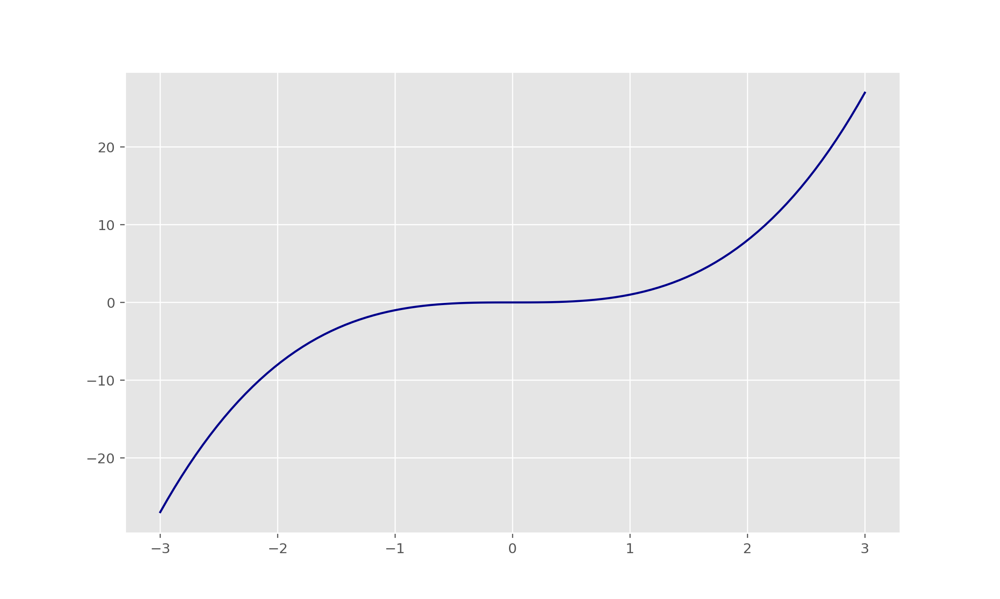

In [71]:
# Construimos el gráfico.
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="darkblue");

Partiremos generando algunas anotaciones mediante el uso de la función `plt.text()` (o el método `ax.text()`, en caso de trabajar con la interfaz orientada a objetos de **Matplotlib**). Escribiremos el nombre y la ecuación asociada a la función anterior. Para ello, haremos uso de los siguientes argumentos: `x` e `y` para especificar las coordenadas asociadas al texto que queremos escribir (por supuesto, referidas al gráfico en cuestión); `s` para especificar el texto en cuestión; `fontsize` para determinar el tamaño del texto; `color` para determinar el color asociado al texto; y `ha` para especificar el alineamiento del texto en relación a las coordenadas que establecimos como ubicación del mismo (`center` para centrar el texto con respecto a tales coordenadas):

<IPython.core.display.Javascript object>


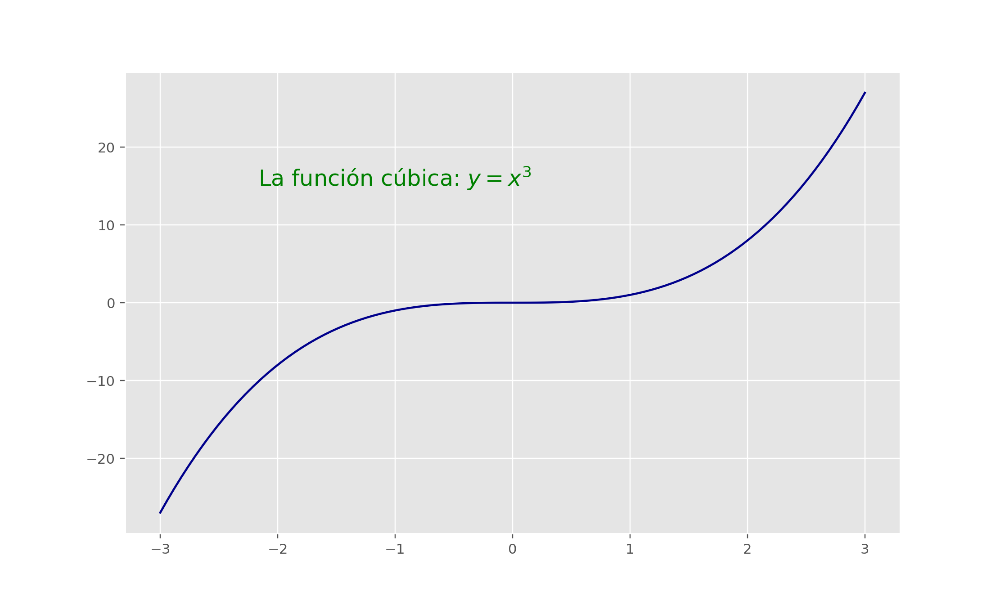

In [72]:
# Una anotación sencilla.
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="darkblue")
ax.text(x=-1, y=15, s=r"La función cúbica: $y=x^{3}$", color="green", fontsize=16, ha="center");

Podemos jugar con las coordenadas asignadas al texto que queremos escribir en un gráfico, pudiendo de esta manera hacer cosas tales como marcar puntos en un gráfico. Marcaremos un punto que pasa por la curva $y=x^{3}$ del gráfico anterior, y generaremos un texto que permita hacer hincapié en dicho punto:

<IPython.core.display.Javascript object>


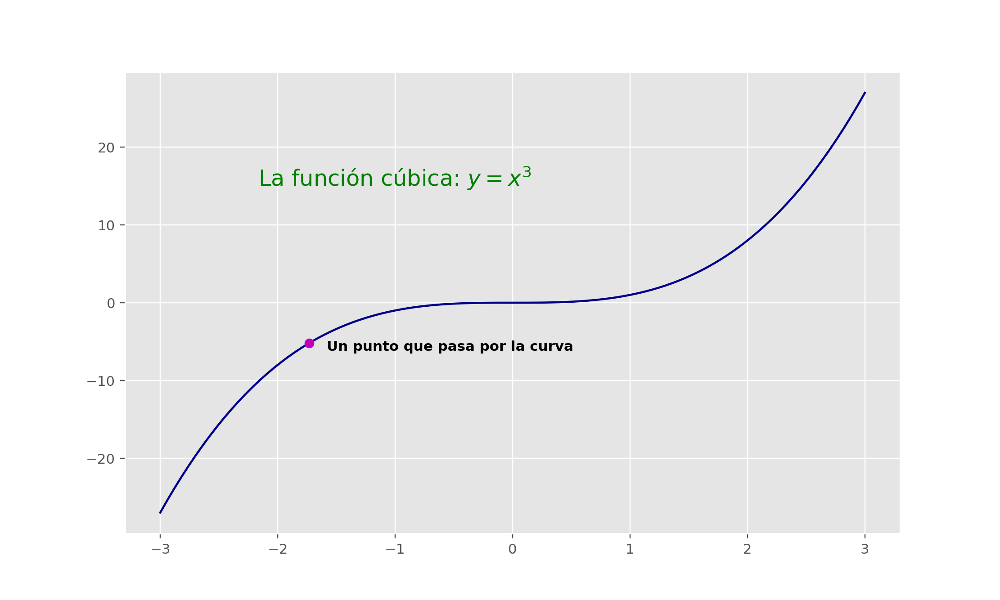

In [73]:
# Más anotaciones.
px = -np.sqrt(3)
py = px**3

fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="darkblue")
ax.plot(px, py, "mo")
ax.text(x=-1, y=15, s=r"La función cúbica: $y=x^{3}$", color="green", fontsize=16, ha="center")
ax.text(
    x=px+0.15, y=py-1, s="Un punto que pasa por la curva", 
    color="black", fontsize=10, ha="left", weight="heavy"
);

Es posible incluso controlar el ángulo respecto del cual se escribe el texto (orientado en relación al eje horizontal) mediante el método `rotation`:

<IPython.core.display.Javascript object>


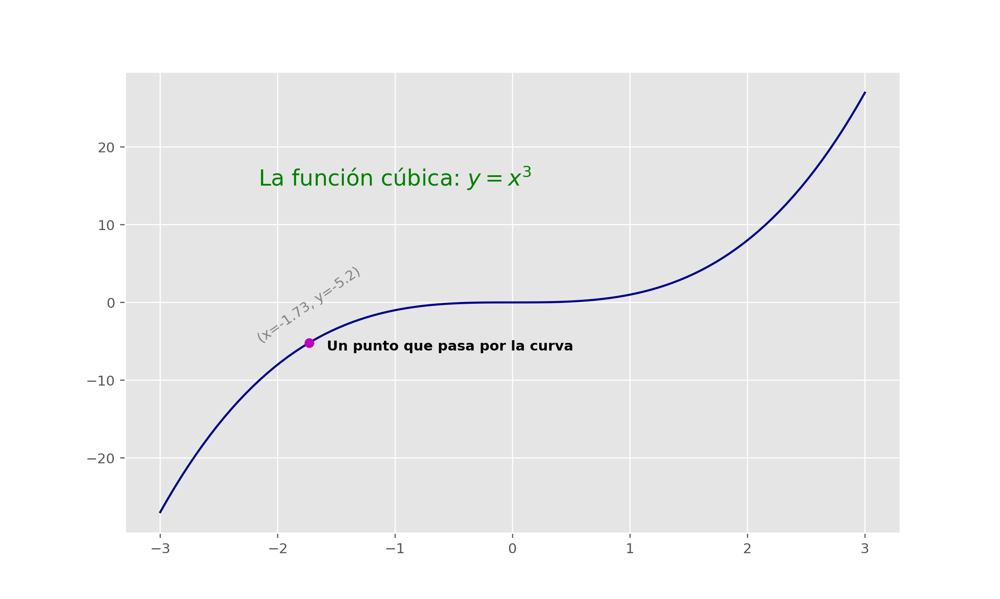

In [74]:
# Y aún más anotaciones...
px = -np.sqrt(3)
py = px**3

fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="darkblue")
ax.plot(px, py, "mo")
ax.text(x=-1, y=15, s=r"La función cúbica: $y=x^{3}$", color="green", fontsize=16, ha="center")
ax.text(
    x=px+0.15, y=py-1, s="Un punto que pasa por la curva", 
    color="black", fontsize=10, ha="left", weight="heavy"
)
ax.text(
    x=px, y=py, s=f"(x={round(px, 2)}, y={round(py, 2)})", 
    color="gray", fontsize=10, ha="center", rotation=35
);

### Transformaciones y posición del texto.
En el ejemplo desarrollado previamente, anclamos nuestras anotaciones a determinadas posiciones (representadas como coordenadas) sobre el objeto tipo `Axes` respectivo o la figura como tal. A veces, es preferible setear nuestras anotaciones en un gráfico independientemente de la data representada en él. En **Matplotlib**, esto se logra modificando ciertas características referidas a los distintos sistemas de referencia que pueden representar la posición relativa de un punto en un gráfico.

Cualquier framework que tenga como objetivo el despliegue de visualizaciones de data necesita de algún esquema para poder traducir distintos sistemas de coordenadas. Por ejemplo, un punto en la posición $(x, y)=(1, 1)$ necesita ser representado, de alguna manera, en un determinado lugar de la figura y, a su vez, también necesita ser representado como pixeles en nuestra pantalla. Matemáticamente, tales transformaciones de coordenadas son relativamente directas, y **Matplotlib** dispone de un buen sistema de herramientas para realizarlas internamente.

En general, rara vez querremos ocuparnos de estas transformaciones. Sin embargo, constituyen conocimiento útil cuando consideramos la inclusión de anotaciones en nuestra figura. En este contexto, existen tres transformaciones pre-definidas que pueden ser útiles:

- `ax.transData`, que es una transformación asociada a las coordenadas representadas por nuestra data.
- `ax.transAxes`, que es una transformación asociada a los objetos de tipo `Axes` que pueblan nuestro gráfico (es decir, paneles), en unidades consistentes con las dimensiones de dicho objeto. Tales dimensiones se expresan en porcentajes del panel completo (por ejemplo, `0.2` hace referencia a una posición relativa al 20% de la dimensión de un eje de un panel).
- `fig.transFigure`, que es una transformación asociada a la figura completa (referida por un objeto de tipo `Figure`), con las mismas referencias en cuanto a dimensión que `ax.transAxes`.

Veamos un ejemplo sencillo:

<IPython.core.display.Javascript object>


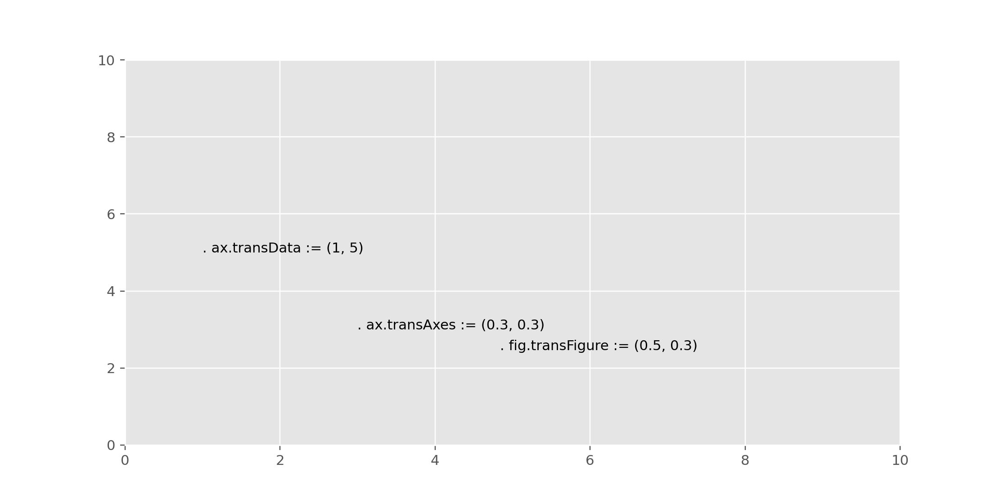

In [75]:
# Generamos una figura con las tres transformaciones aplicadas a la creacion de textos.
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_xlim(0, 10)
ax.set_ylim(0, 10)

# Opción por defecto.
ax.text(x=1, y=5, s=". ax.transData := (1, 5)", transform=ax.transData, ha="left")

# Referencia sobre el panel.
ax.text(x=0.3, y=0.3, s=". ax.transAxes := (0.3, 0.3)", transform=ax.transAxes, ha="left")

# Referencia sobe la figura.
ax.text(x=0.5, y=0.3, s=". fig.transFigure := (0.5, 0.3)", transform=fig.transFigure, ha="left");

Notemos que, por defecto, el texto se alinea arriba a la derecha de las coordenadas especificadas. Aquí, el símbolo `"."` al principio de cada string definido en el parámetro `s` representa, aproximadamente, una marca que nos aclara donde están las coordenadas especificadas para nuestro texto en cada transformación.

Las coordenadas en el sistema`ax transData` están definidas conforme la data puntual que estamos graficando. En el sistema `ax.transAxes`, están definidas en porcentualmente de manera relativa al objeto tipo `Axes`(panel) donde se inscribe el gráfico (es la caja de color gris más claro). Las coordenadas en el sistema `ax.transFigure` son similares a las anteriores, pero con respecto a la figura completa (cuyos bordes están al exterior de las marcas de graduación e cada eje).

Notemos ahora que, si cambiamos los límites del objeto tipo `Axes`, solamente se verá afectado en su posición el texto definido en el sistema `ax.transData`, mientras que el resto de las anotaciones permanecerán estacionarias:

<IPython.core.display.Javascript object>


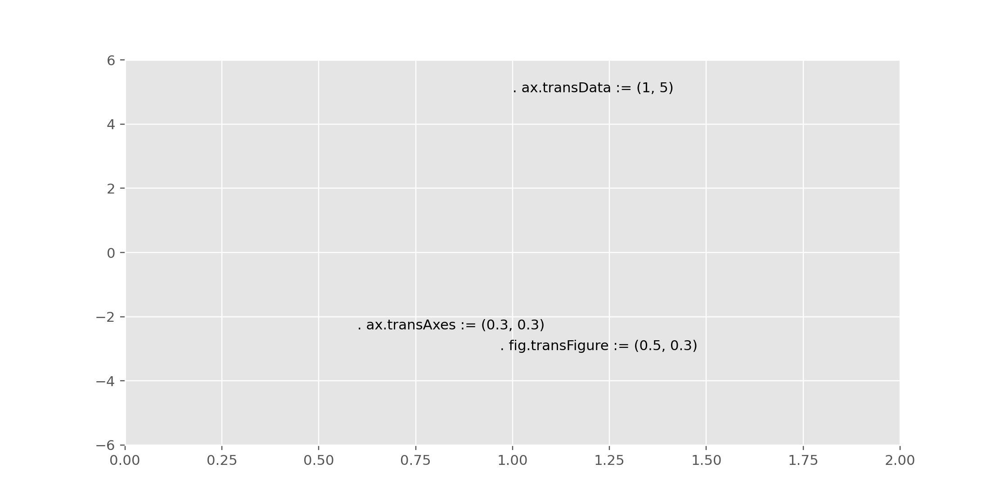

In [76]:
# Cambio en los límites de los ejes del gráfico.
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_xlim(0, 2)
ax.set_ylim(-6, 6)

# Opción por defecto.
ax.text(x=1, y=5, s=". ax.transData := (1, 5)", transform=ax.transData, ha="left")

# Referencia sobre el panel.
ax.text(x=0.3, y=0.3, s=". ax.transAxes := (0.3, 0.3)", transform=ax.transAxes, ha="left")

# Referencia sobe la figura.
ax.text(x=0.5, y=0.3, s=". fig.transFigure := (0.5, 0.3)", transform=fig.transFigure, ha="left");

### Flechas y anotaciones.
Además de los marcadores y el propio texto, otro tipo de anotación muy útil en los gráficos corresponde a las flechas, las que permiten relacionar un determinado texto en referencia a algún elemento del mismo gráfico (por ejemplo, una curva). Para ello, **Matplotlib** dispone de la función `plt.annotate()`, la que consta de varios parámetros que permiten referenciar las posiciones de las flechas y el texto asociado a ellas (entre otros elementos).

Ejemplifiquemos ésto con un gráfico sencillo:

In [77]:
# Creamos algo de data.
x = np.linspace(start=-10, stop=10, num=100)
y = 3*x**2 + 2*x + 6

<IPython.core.display.Javascript object>


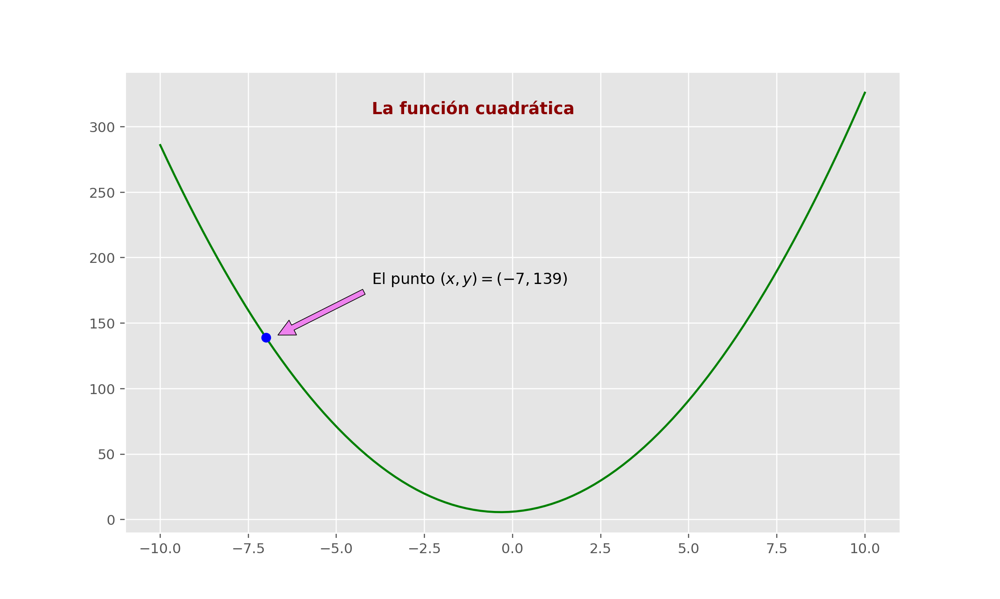

In [78]:
# Un ejemplo sencillo de anotación y flecha.
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="green")
ax.plot(-7, 3*(-7)**2 + 2*(-7) + 6, "bo")

# Generamos algunas anotaciones sencillas.
ax.annotate(
    text=r"El punto $(x, y)=(-7, 139)$", xy=(-6.8, 139), xytext=(-4, 180), size=11,
    arrowprops=dict(facecolor="violet", shrink=0.05, edgecolor="k")
)
ax.text(x=-4, y=310, s="La función cuadrática", size=12, weight="heavy", color="darkred");

Vemos que el texto que hemos construido referencia un determinado elemento del gráfico al mismo por medio de una flecha. En este caso, la función `plt.annotate()` hace uso del parámetro `text` para definir el texto que queremos mostrar en el gráfico; `xy` para especificar las coordenadas en el gráfico hacia las cuales apunta la flecha; `xytext` para especificar las coordenadas en el gráfico donde se escribe el texto (el que, en esta ocasión, se alinea a la izquierda); `size` para definir el tamaño del texto en cuestión; y `arrowprops`, que es un diccionario que agrupa una serie de parámetros estéticos propios de la flecha que queremos dibujar. En nuestro ejemplo anterior, hemos definido tres de esos parámetros: `facecolor`, que define el color del relleno de la flecha, `edgecolor`, que define el color de los bordes de la flecha, y `shrink`, que corresponde al porcentaje de la longitud original de la flecha respecto de la cual ésta se contrae (meramente para evitar superposiciones del texto y la flecha).

El diccionario `arrowprops` permite personalizar otros aspectos de las flechas, tales como su forma y geometría. Por ejemplo, podemos usar el parámetro `arrowstyle` para definir la forma de la punta de la flecha:

<IPython.core.display.Javascript object>


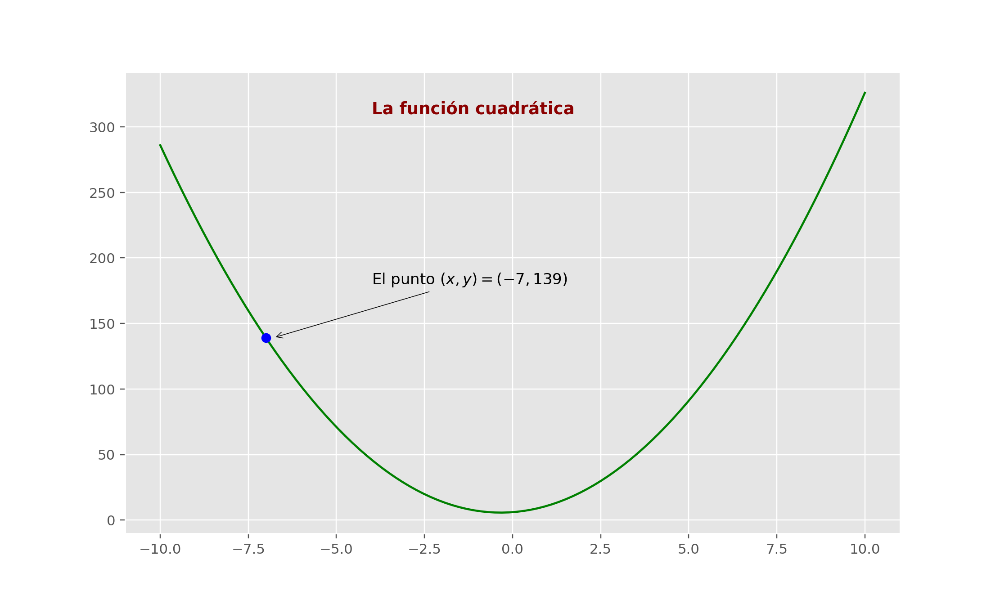

In [79]:
# Más opciones de personalización de flechas.
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="green")
ax.plot(-7, 3*(-7)**2 + 2*(-7) + 6, "bo")

# Opciones de personalización de flechas.
arrowprops=dict(color="black", arrowstyle="->")

# Generamos algunas anotaciones sencillas.
ax.annotate(
    text=r"El punto $(x, y)=(-7, 139)$", xy=(-6.8, 139), xytext=(-4, 180), size=11,
    arrowprops=arrowprops
)
ax.text(x=-4, y=310, s="La función cuadrática", size=12, weight="heavy", color="darkred");

Vemos que el parámetro `arrowstyle` acepta strings que definen la forma de la punta de flecha. En el ejemplo anterior, `"->"` implica una flecha muy simple, sin relleno en la punta. Otras opciones incluyen `"<-` para invertir el sentido de la flecha, `<->` para que la flecha apunte en ambas direcciones.

Una flecha con relleno en la punta puede especificarse con el string `"-|>"`, con la misma lógica anterior para invertir su sentido o para que la flecha apunte en ambas direcciones:

<IPython.core.display.Javascript object>


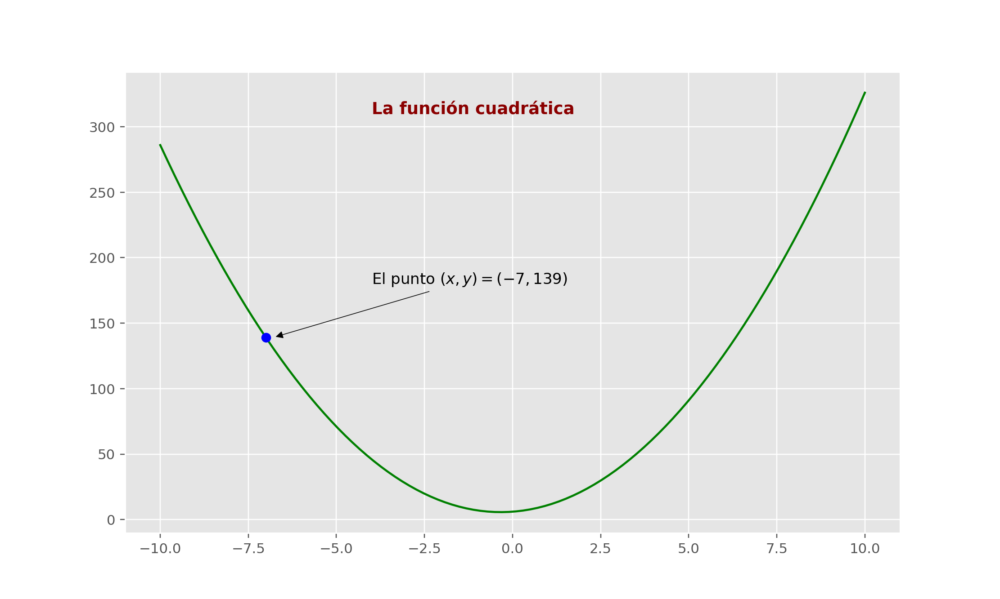

In [80]:
# Más opciones de personalización de flechas.
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="green")
ax.plot(-7, 3*(-7)**2 + 2*(-7) + 6, "bo")

# Opciones de personalización de flechas.
arrowprops=dict(color="black", arrowstyle="-|>")

# Generamos algunas anotaciones sencillas.
ax.annotate(
    text=r"El punto $(x, y)=(-7, 139)$", xy=(-6.8, 139), xytext=(-4, 180), size=11,
    arrowprops=arrowprops
)
ax.text(x=-4, y=310, s="La función cuadrática", size=12, weight="heavy", color="darkred");

Es posible agregar otros tipos más elegantes o divertidos de flechas. Por ejemplo, podemos usar flechas con forma de cuña y agregar transparencia a los colores correspondientes de la misma mediante el argumento `alpha`, encerrando además el texto en una bonita caja mediante el argumento `bbox`, que también es un diccionario (y que también aplica para la función `plt.text()`:

<IPython.core.display.Javascript object>


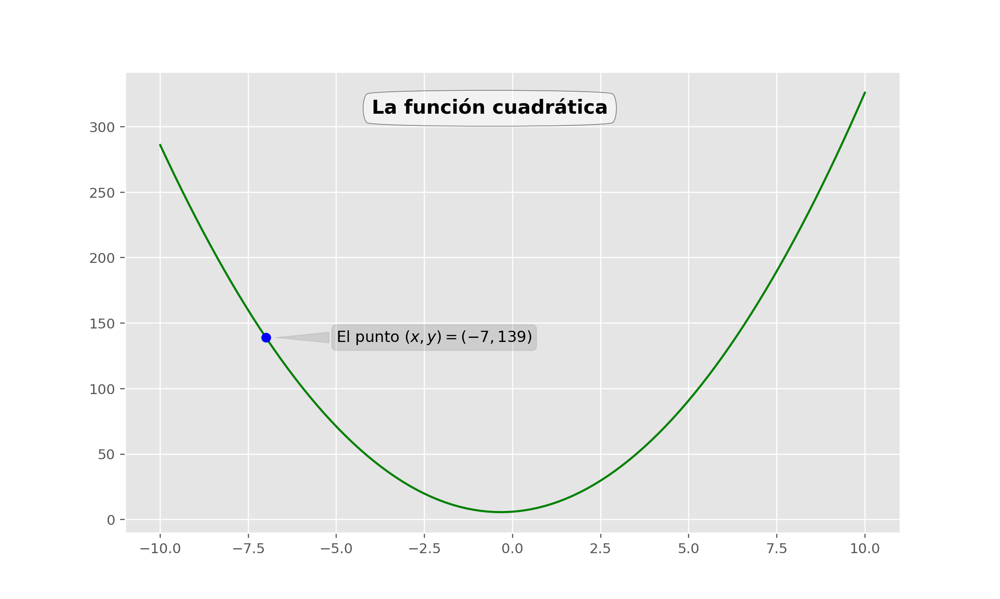

In [81]:
# Y más opciones de personalización de flechas....
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(x, y, color="green")
ax.plot(-7, 3*(-7)**2 + 2*(-7) + 6, "bo")

bbox = dict(boxstyle="round", alpha=0.1, color="black")
arrowprops = dict(color="black", arrowstyle="wedge,tail_width=0.7", alpha=0.1)

# Generamos algunas anotaciones sencillas.
ax.annotate(
    text=r"El punto $(x, y)=(-7, 139)$", xy=(-6.8, 139), xytext=(-5.0, 139), size=11,
    va="center", arrowprops=arrowprops, bbox=bbox
)
ax.text(
    x=-4, y=310, s="La función cuadrática", size=14, weight="heavy", color="black",
    bbox=dict(boxstyle="round4,pad=.5", alpha=0.5, fc="white", ec="black")
);

Otras opciones para la personalización de flechas y texto per se pueden revisar en la [documentación oficial](https://matplotlib.org/stable/api/_as_gen/matplotlib.patches.FancyArrowPatch.html#matplotlib.patches.FancyArrowPatch) de **Matplotlib**.

## Personalización de marcas de graduación.
Los localizadores y formateadores de *ticks* (que son el nombre el inglés para las marcas de graduación en un gráfico) de ejes de **Matplotlib** están diseñados para ser, por defecto, suficientes en el común de las situaciones. Sin embargo, en ningún caso son soluciones optimas para cualquier gráfico. En esta subsección, daremos algunos ejemplos de cómo ajustar las localizaciones de estos *ticks* y cómo formatearlos para los casos particulares que eventualmente queramos tratar.

Sin embargo, antes de ir de lleno al código, es bueno que entendamos el funcionamiento de la jerarquía de objetos de los gráficos de **Matplotlib**. **Matplotlib** tiene como objetivo el disponer un objeto de Python que represente todo lo que aparece en un gráfico. Por ejemplo, recordemos que `Figure` es la *caja* que limita nuestro gráfico (o grilla de gráficos) y que contiene todos los objetos de tipo `Axes` que pueblan nuestra figura. Es decir, cada objeto de **Matplotlib** puede funcionar como un contenedor de otros objetos. Los *ticks* de un eje no son excepciones a esta jerarquía. Cada objeto de tipo `Axes` tiene atributos `xaxis` e `yaxis`, que, a su vez, contienen las propiedades de las líneas, *ticks* y marcadores que conforman nuestro gráfico.

### Marcas de *ticks*.
Respecto de cada eje, existe el concepto de marca mayor (o menor) de tick. Como estos nombres lo implican, los ticks mayores son, en general, más grandes y pronunciados, mientras que los ticks menores son más pequeños. Por defecto, rara vez **Matplotlib** hará uso de ticks menores, pero un caso en el cual siempre los veremos será en gráficos con escala logarítmica:

<IPython.core.display.Javascript object>


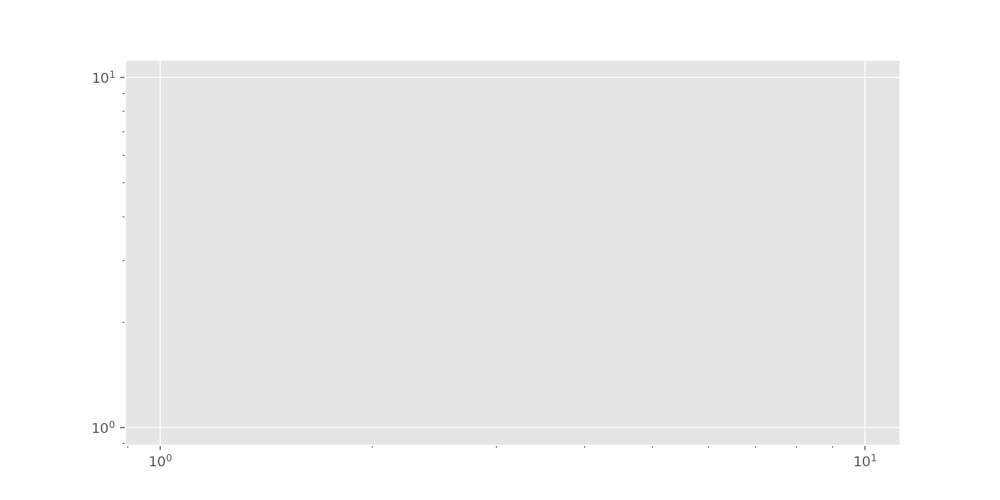

In [82]:
# La escala de un gráfico se setea en la función plt.axes().
fig = plt.figure(figsize=(10, 5))
ax = plt.axes(xscale='log', yscale='log')
ax.grid(True);

Podemos ver, en la caja que se ha dibujado previamente, que cada tick mayor se muestra con un marcador grande y definido, mientras que los ticks menores se muestran mediante marcadores más pequeños, y sin un rótulo que los defina. Estas propiedades de los ticks (localizaciones y etiquetas), pueden ser personalizadas mediante el seteo de los objetos `formatter` y `locator` para cada eje del gráfico. Examinemos estos objetos para el eje X del gráfico que acabamos de mostrar:

In [84]:
# Los objetos de tipo locator().
print(ax.xaxis.get_major_locator())
print(ax.xaxis.get_minor_locator())

In [85]:
# Los objetos de tipo formatter().
print(ax.xaxis.get_major_formatter())
print(ax.xaxis.get_minor_formatter())

Vemos que ambos, ticks mayores y menores, tienen sus localizaciones especificadas mediante un objeto de tipo `LogLocator` (lo que tiene sentido para un gráfico con escala logarítmica). Sin embargo, los ticks menores tienen sus etiquetas formateadas mediante un objeto de tipo `NullFormatter`: Esto quiere decir que no se mostrarán etiquetas en el gráfico para estos ticks.

### Ocultamiento de ticks.
Quizás la operación más común de formateo de etiquetas de ticks en **Matplotlib** corresponda al ocultamiento de dichas etiquetas o de las mismas marcas de graduación. Esto puede lograrse mediante las clases `plt.NullLocator()` y `plt.NullFormatter()`, como se muestra en el siguiente bloque de código:

In [86]:
# Definimos algo de data.
x = np.linspace(start=0, stop=100, num=1000)
y = np.sin(x)*np.cos(x)

<IPython.core.display.Javascript object>


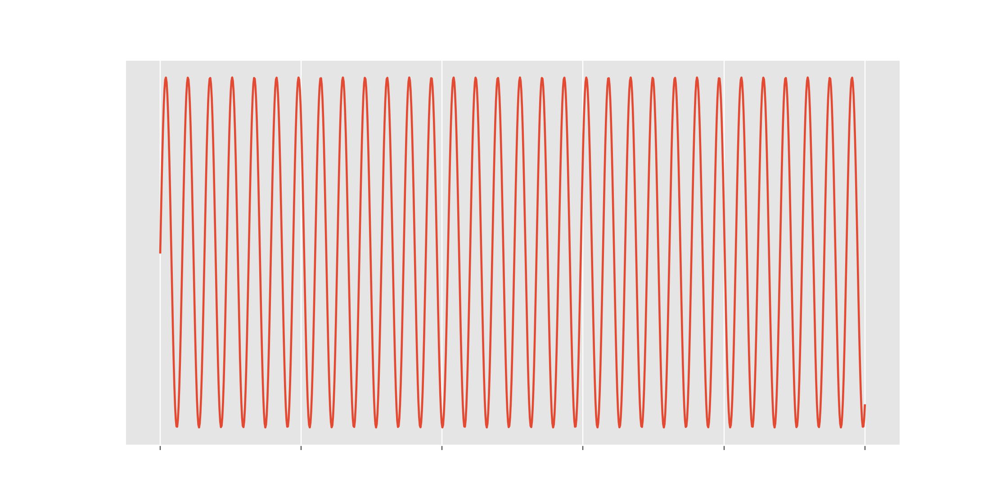

In [87]:
# Construimos nuestro gráfico.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, y)
ax.yaxis.set_major_locator(plt.NullLocator())
ax.xaxis.set_major_formatter(plt.NullFormatter());

Notemos que hemos removido las etiquetas del eje X, y los ticks (y, por extensión, también las etiquetas) del eje Y. No tener ninguna marca de graduación en absoluto puede ser de utilidad en varias situaciones. Por ejemplo, cuando queremos mostrar una grilla de imágenes. Consideremos la siguiente figura, la que incluye imágenes de diferentes rostros:

In [88]:
# Cargamos el dataset de rostros de Olivetti, usando la librería Scikit-Learn.
from sklearn.datasets import fetch_olivetti_faces

In [89]:
# Cargamos la data relativa a estas imágenes.
faces = fetch_olivetti_faces().images

<IPython.core.display.Javascript object>


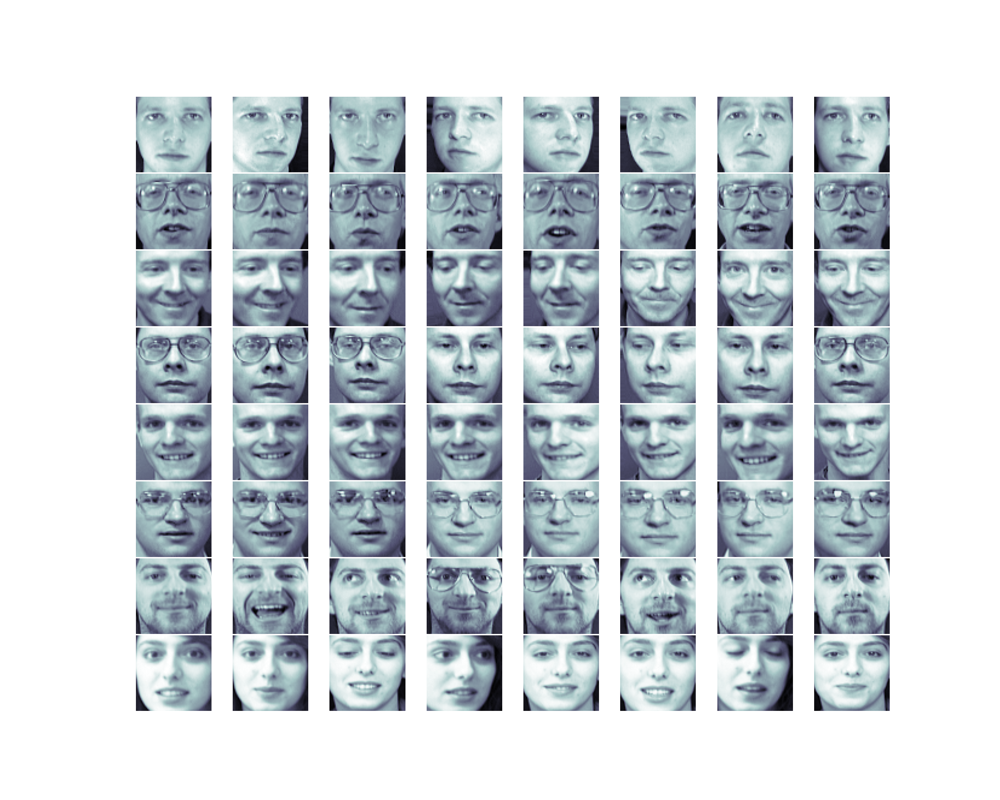

In [90]:
# Construimos nuestro gráfico.
fig, ax = plt.subplots(nrows=8, ncols=8, figsize=(10, 8))
fig.subplots_adjust(hspace=0, wspace=0)

for i in range(8):
    for j in range(8):
        ax[i, j].xaxis.set_major_locator(plt.NullLocator())
        ax[i, j].yaxis.set_major_locator(plt.NullLocator())
        ax[i, j].imshow(faces[10 * i + j], cmap="bone")

Notemos que cada imagen tiene su propio objeto de tipo `Axes`, y hemos seteado los localizadores conforme objetos de tipo `plt.NullLocator()` debido a que los valores de cada tick (número de pixeles en este caso) no transmiten información particularmente útil para este tipo de visualización.

### Reducción o incremento del número de ticks.
Un problema común que se da con las opciones por defecto de **Matplotlib** es que los subgráficos muy pequeños en una grilla quedan con una especie de *sobrepoblación* de rótulos (que pueden tender a superponerse entre sí). Esto lo podemos ilustrar mediante el bloque de código siguiente:

<IPython.core.display.Javascript object>


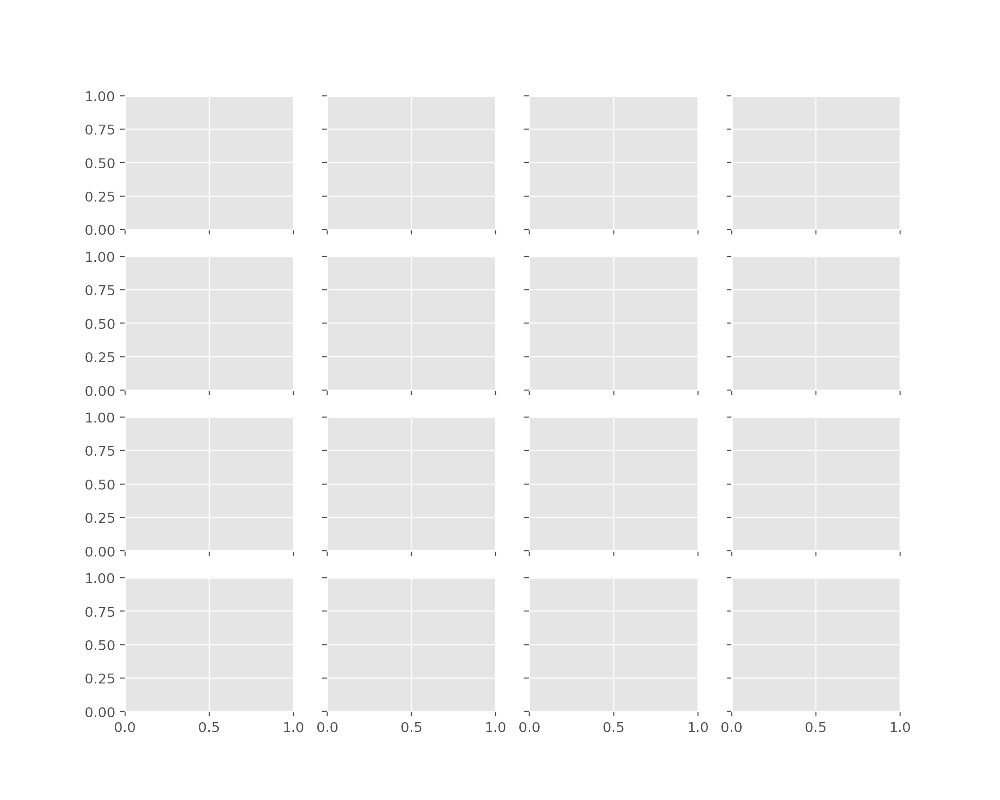

In [95]:
# Una grilla de gráficos pequeños.
fig, ax = plt.subplots(nrows=4, ncols=4, sharex=True, sharey=True, figsize=(10, 8))

Particularmente para los ticks del eje X, los números casi se superponen y se hacen difíciles de individualizar en las esquinas de cada gráfico. Podemos arreglar esto usando la clase `plt.MaxLocator()`, que nos permite especificar el número de ticks que serán mostrados:

<IPython.core.display.Javascript object>


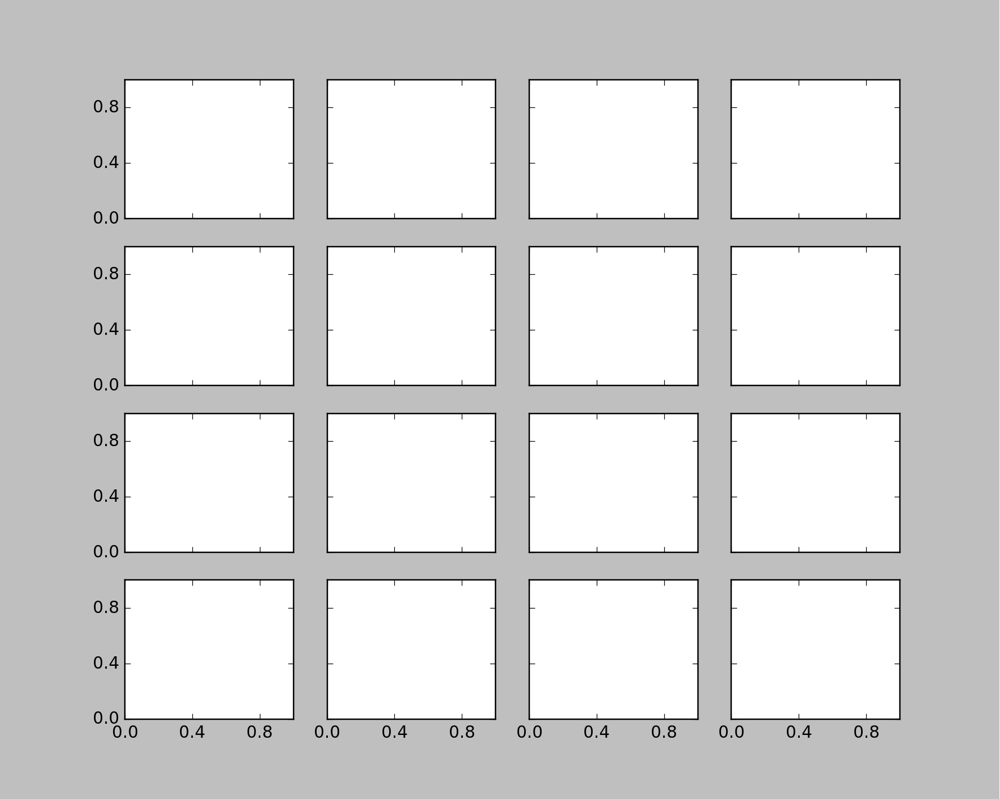

In [106]:
# Para cada eje, seteamos los localizadores máximos para X e Y en 3.
fig, ax = plt.subplots(nrows=4, ncols=4, sharex=True, sharey=True, figsize=(10, 8))
for ax_j in ax.flat:
    ax_j.xaxis.set_major_locator(plt.MaxNLocator(3))
    ax_j.yaxis.set_major_locator(plt.MaxNLocator(3))

Esto permite que la grilla se vea mucho más limpia.

### Formatos más personalizados de ticks.
El formato de ticks por defecto de **Matplotlib** puede dejar mucho que desear. Funciona bien, pero puede ser mejor. Consideremos el siguiente gráfico de funciones trigonométricas:

<IPython.core.display.Javascript object>


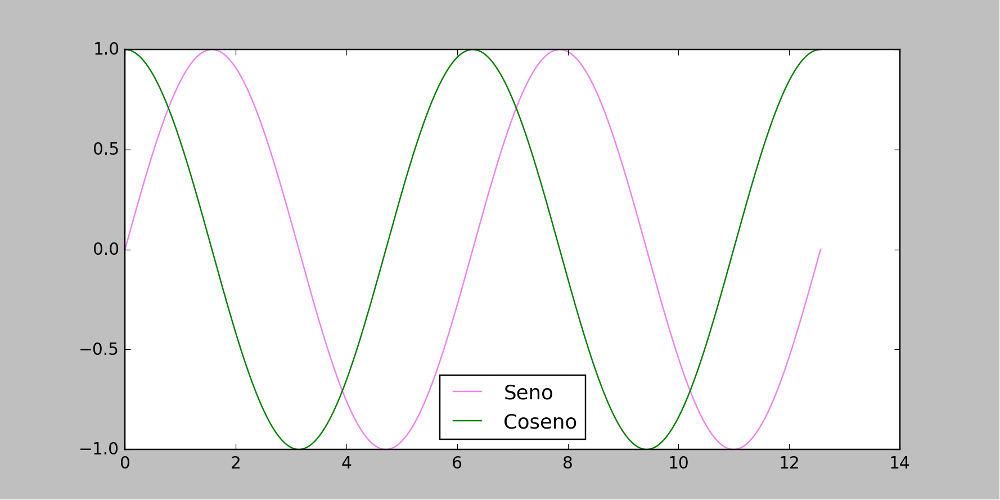

In [107]:
# Las curvas seno y coseno.
x = np.linspace(start=0, stop=4*np.pi, num=1000)

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), color="violet", label='Seno')
ax.plot(x, np.cos(x), color="green", label='Coseno')
ax.legend(loc="best", frameon=True);

Hay un par de cambios que nos podría gustar hacer. Primero, resulta más natural, para esta data, espaciar los ticks en múltiplos de $\pi$. Podemos lograr esto mediante el uso de la clase `plt.MultipleLocator()`, la que permite localizar los ticks sobre el múltiplo de un número que nosotros proveamos. Por ejemplo, múltiplos de $\pi/4$:

<IPython.core.display.Javascript object>


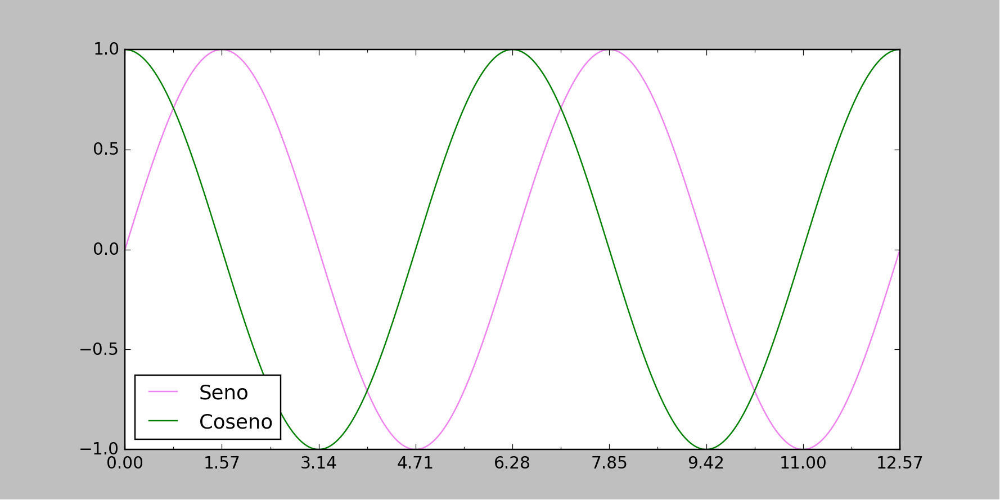

In [108]:
# Personalizamos los ticks del gráfico anterior.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), color="violet", label='Seno')
ax.plot(x, np.cos(x), color="green", label='Coseno')
ax.legend(loc="best", frameon=True);
ax.xaxis.set_major_locator(plt.MultipleLocator(np.pi / 2))
ax.xaxis.set_minor_locator(plt.MultipleLocator(np.pi / 4))

Sin embargo, estos ticks se ven un tanto difíciles de digerir. Podríamos querer que los rótulos de cada tick muestren explícitamente el múltiplo respectivo de $\pi$ que queremos representar. Y para ello, requerimos de un formateador de ticks. No existe uno en **Matplotlib** que haga esto específicamente, pero la clase `plt.FuncFormatter()` acepta cualquier función definida por nosotros que permita definir el formato de los ticks de un gráfico. Un ejemplo podría ser:

In [109]:
# Una función que formatea nuestros ticks.
def format_func(value, tick_number):
    # Encontramos el número de múltiplos de pi/2
    N = int(np.round(2 * value / np.pi))
    if N == 0:
        return "0"
    elif N == 1:
        return r"$\pi/2$"
    elif N == 2:
        return r"$\pi$"
    elif N % 2 > 0:
        return r"${0}\pi/2$".format(N)
    else:
        return r"${0}\pi$".format(N // 2)

<IPython.core.display.Javascript object>


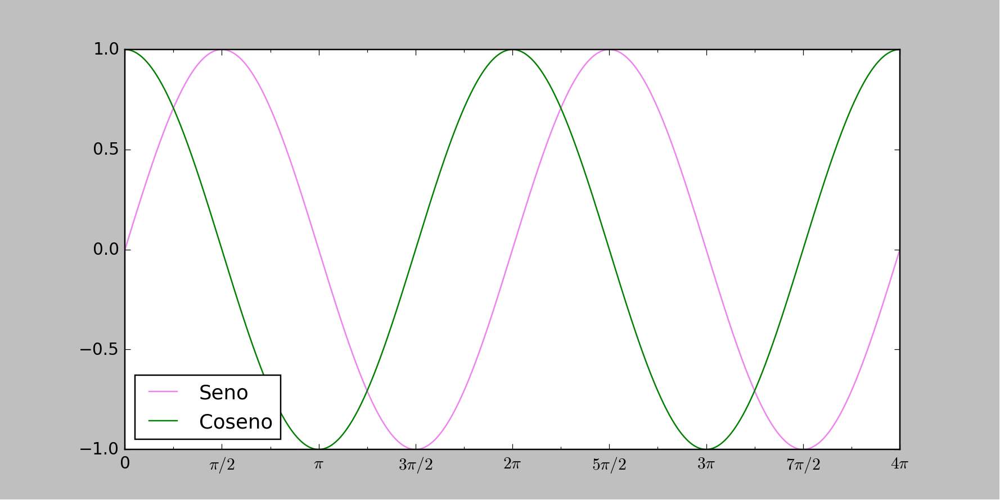

In [110]:
# Y ahora sí, personalizamos nuestros ticks.
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, np.sin(x), color="violet", label='Seno')
ax.plot(x, np.cos(x), color="green", label='Coseno')
ax.legend(loc="best", frameon=True);
ax.xaxis.set_major_locator(plt.MultipleLocator(np.pi / 2))
ax.xaxis.set_minor_locator(plt.MultipleLocator(np.pi / 4))
ax.xaxis.set_major_formatter(plt.FuncFormatter(format_func))

Y eso está mucho mejor. Notemos que hemos hecho uso del soporte de **Matplotlib** para LaTeX, especificado mediante el encierro de caracteres entre signos `$` (también anteponiendo la r antes de un string, para que los caracteres de tipo `\` sean legibles). Esto resulta conveniente para mostrar en pantalla símbolos matemáticos típicos. Por ejemplo, el símbolo $\pi$ se renderiza escribiendo `r"$\pi$"`.

## Configuración de estilos.
Los settings asociados por defecto a los gráficos de **Matplotlib** suelen ser fuertemente criticados por los usuarios de esta librería. Mientras que muchas de estas opciones se han ido cambiando en distintos lanzamientos de nuevas versiones de **Matplotlib**, la capacidad de la librería de permitirnos cambiar elementos estéticos de nuestros gráficos nos permite adecuar cualquier elemento gráfico a nuestro gusto personal. En esta subsección, echaremos un vistazo a algunas opciones de configuración de tiempo de ejecución (RC) de **Matplotlib**, con énfasis en las templates u hojas de estilo (`stylesheets`) que nos permiten setear muy buenas características por defecto para nuestros graficos.

### Personalización manual de elementos estéticos.
A través de esta clase hemos visto que es posible personalizar un montón de elementos de los gráficos de **Matplotlib** para que puedan verse mejor que sus versiones por defecto. Podemos, por supuesto, realizar estos cambios para cada gráfico individual. Por ejemplo:

In [111]:
# La piel "clásica" de Matplotlib.
plt.style.use('classic')

In [112]:
# Creamos algo de data.
x = rng.integers(low=1, high=10, size=1000)

<IPython.core.display.Javascript object>


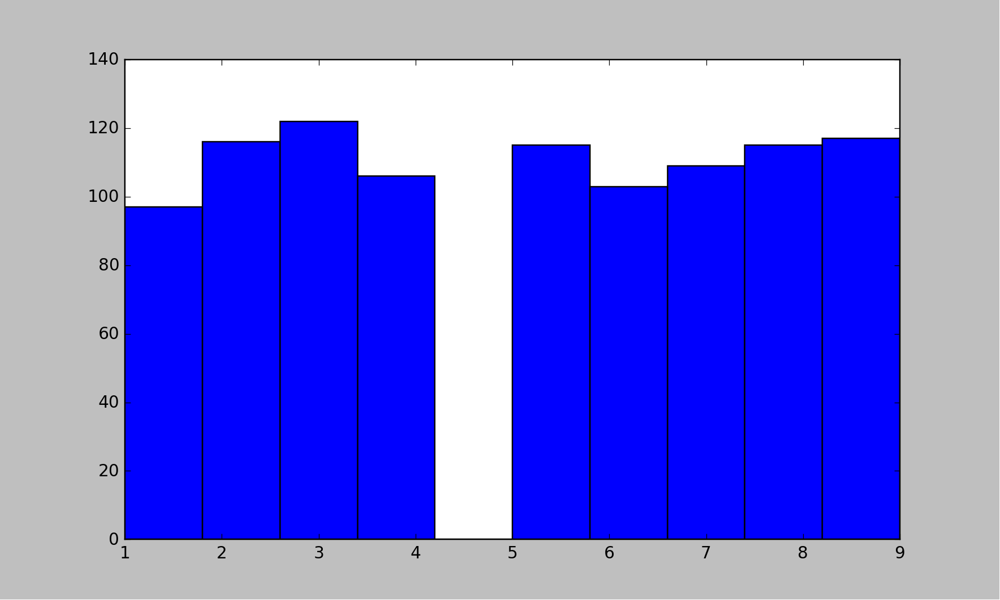

In [113]:
# Creamos un histograma sencillo, con esta piel por defecto.
plt.figure(figsize=(10, 6))
plt.hist(x);

Evidentemente este gráfico no destaca por su belleza. Afortunadamente, podemos ajustar varias opciones manualmente para hacer que este gráfico se vea mejor, logrando lo que se muestra a continuación:

<IPython.core.display.Javascript object>


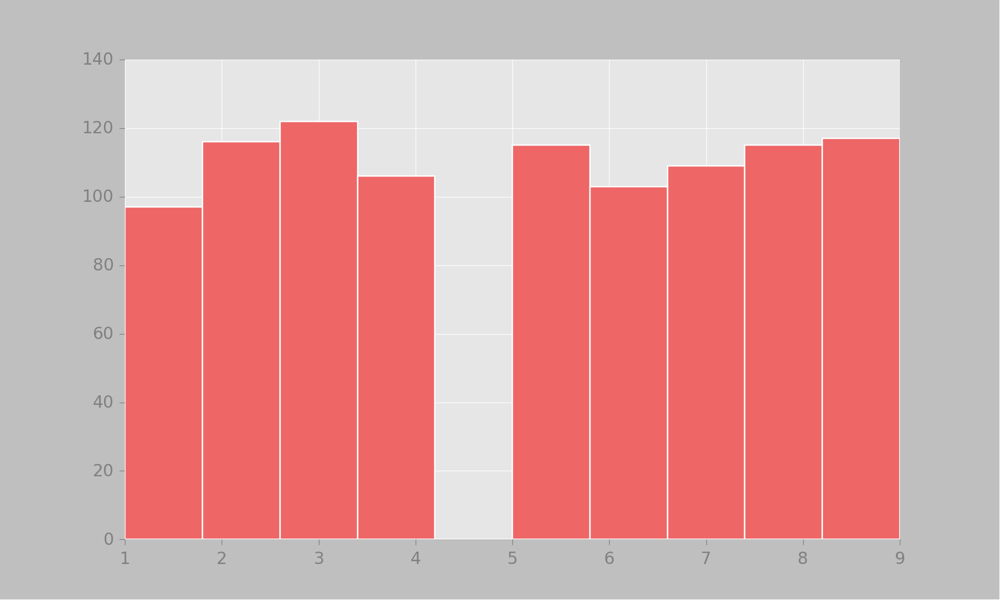

In [114]:
# Usamos un fondo gris.
plt.figure(figsize=(10, 6))
ax = plt.axes(facecolor='#E6E6E6')
ax.set_axisbelow(True)

# Dibujamos líneas sólidas blancas que definan una cuadrícula.
plt.grid(color='w', linestyle='solid')

# Ocultamos los delimitadores de ejes.
for spine_j in ax.spines.values():
    spine_j.set_visible(False)

# Ocultamos el tick superior y el derecho.
ax.xaxis.tick_bottom()
ax.yaxis.tick_left()

# Alivianamos ticks y etiquetas.
ax.tick_params(colors='gray', direction='out')
for tick in ax.get_xticklabels():
    tick.set_color('gray')
for tick in ax.get_yticklabels():
    tick.set_color('gray')
    
# Controlamos los colores de líneas y relleno del histograma.
ax.hist(x, edgecolor='white', color='#EE6666');

Ahora está mejor. Si hemos visto gráficos renderizados mediante librerías de R (como `ggplot2`), claramente reconoceremos de donde viene la inspiración para este gráfico (aunque `ggplot2` es, en mi humilde opinión una opción muchísimo más sofisticada que **Matplotlib**). Sin embargo, lo anterior tomó muchísimo esfuerzo, y definitivamente no queremos tener que repetirlo para cada gráfico que hagamos.

### Cambio de los parámetros por defecto en Matplotlib.
Cada vez que importamos la librería **Matplotlib**, se define una configuración de tiempo de ejecución (*runtime configuration* o **RC**) que define los elementos por defecto de cada gráfico que creemos. Dicha configuración puede ser modificada cuando queramos mediante la rutina `plt.rc`. Veamos qué ocurre cuando modificamos los parámetros de RC, de manera que podamos ajustar los valores por defecto y que éstos se repitan cada vez que construyamos un gráfico, a fin de evitarnos todo el trabajo anerior.

Partiremos guardando un copia de los valores por defecto de los parámetros RC, de manera que podamos recuperar estos parámetros fácilmente en cualquier momento:

In [116]:
# Guardamos la configuración por defecto actual, en caso de...
IPython_default = plt.rcParams.copy()

Ahora podemos usar la función `plt.rc()` para cambiar algunos de estos parámetros:

In [117]:
from matplotlib import cycler

In [118]:
# Nuevos colores por defecto. Se ciclan conforme la secuencia definida en la función cicler().
colors = cycler('color', ['#EE6666', '#3388BB', '#9988DD', '#EECC55', '#88BB44', '#FFBBBB'])

In [119]:
# Definimos los parámetros por defecto a nuestro antojo.
plt.rc(
    'axes', facecolor='#E6E6E6', edgecolor='none', axisbelow=True, grid=True, prop_cycle=colors
)
plt.rc('grid', color='w', linestyle='solid')
plt.rc('xtick', direction='out', color='gray')
plt.rc('ytick', direction='out', color='gray')
plt.rc('patch', edgecolor='#E6E6E6')
plt.rc('lines', linewidth=2)

Con estas opciones ya seteadas, podemos crear un gráfico y ver qué apariencia tiene:

<IPython.core.display.Javascript object>


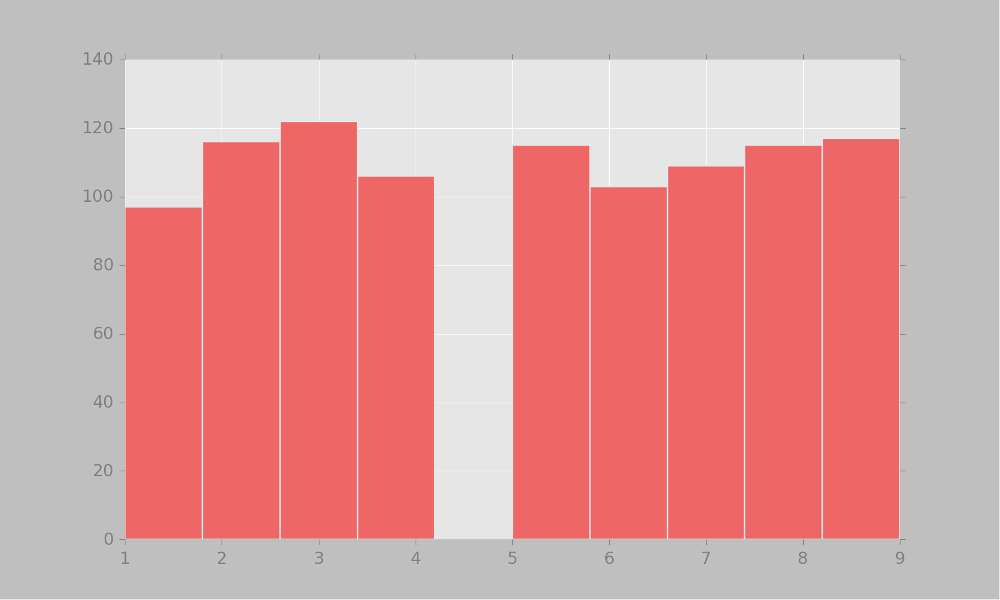

In [120]:
# Observamos ahora la apariencia de un gráfico por defecto.
plt.figure(figsize=(10, 6))
plt.hist(x);

Es probable que encontremos que estas opciones personalizadas sean estéticamente mucho más atractivas que las que hay por defecto. Aunque, naturalmente, podemos cambiarlas por otras que nos resulten mucho más satisfactorias.

### Hojas de estilo (*stylesheets*).
**Matplotlib** incluye un buen número de hojas de estilo o *stylesheets* por defecto, así como la habilidad de crear y empaquetar nuestros propios estilos. Tales *stylesheets* pueden listarse mediante `plt.style.available`. Por ejemplo, las primeras diez son las siguientes (y pueden setearse mediante la función `plt.style.use()`:

In [121]:
# Los primeros diez estilos que podemos encontrar en la lista completa de Matplotlib.
plt.style.available[:10]

['Solarize_Light2',
 '_classic_test_patch',
 '_mpl-gallery',
 '_mpl-gallery-nogrid',
 'bmh',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot']

Si bien es posible setear una hoja de estilos mediante la función `plt.style.use()`, como ya hemos hecho previamente, dicho setting es permanente, hasta que volvamos a cambiarlo mediante el uso de la misma función. Sin embargo, **Matplotlib** nos ofrece un *administrador contextual*, representado por la función `plt.style.context()`, y que podemos usar para un único gráfico:

In [122]:
# Creamos algo de data.
x = rng.normal(loc=0, scale=1, size=1000)
x1 = np.random.default_rng(1).integers(low=1, high=10, size=10)
x2 = np.random.default_rng(2).integers(low=1, high=10, size=10)
x3 = np.random.default_rng(3).integers(low=1, high=10, size=10)

<IPython.core.display.Javascript object>


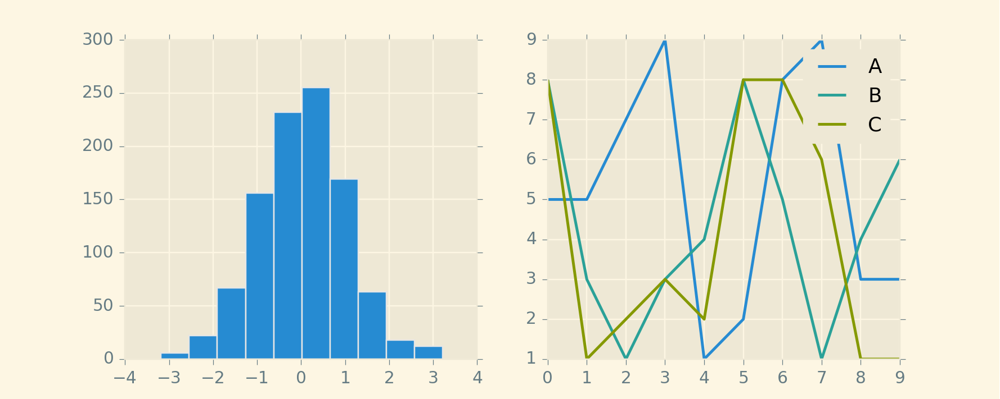

<IPython.core.display.Javascript object>


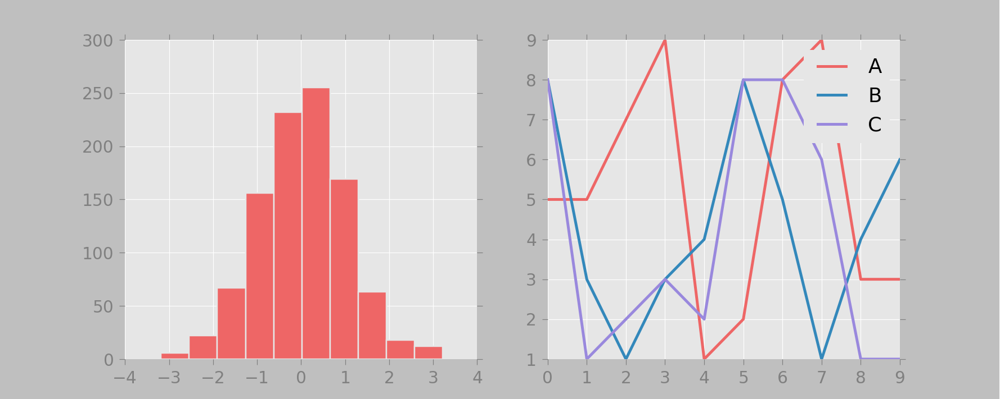

<IPython.core.display.Javascript object>


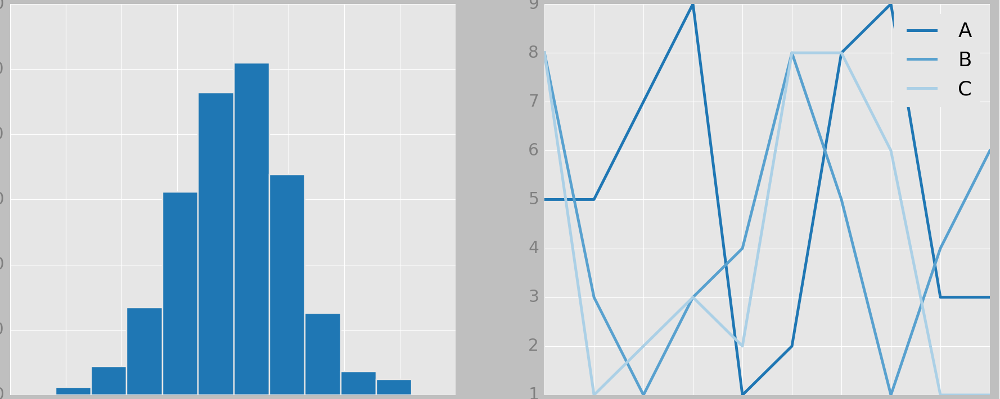

<IPython.core.display.Javascript object>


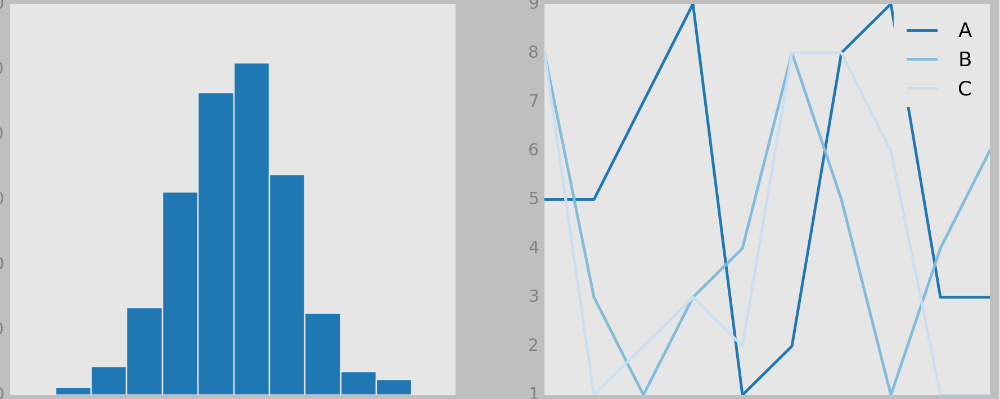

<IPython.core.display.Javascript object>


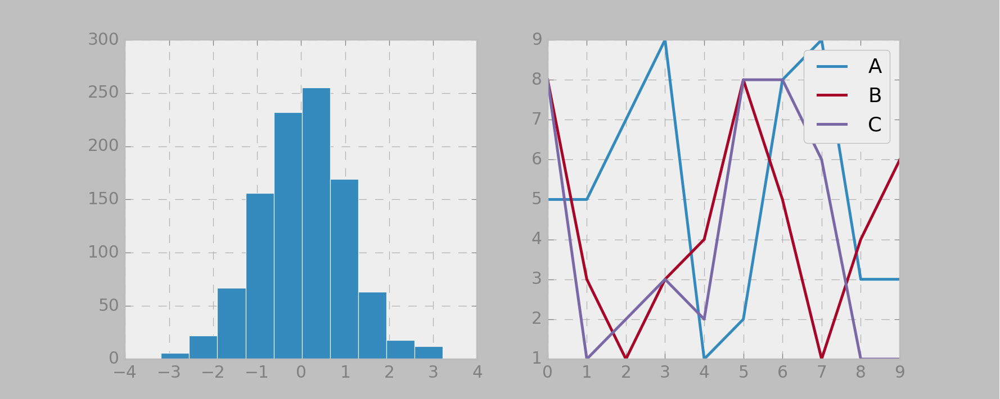

<IPython.core.display.Javascript object>


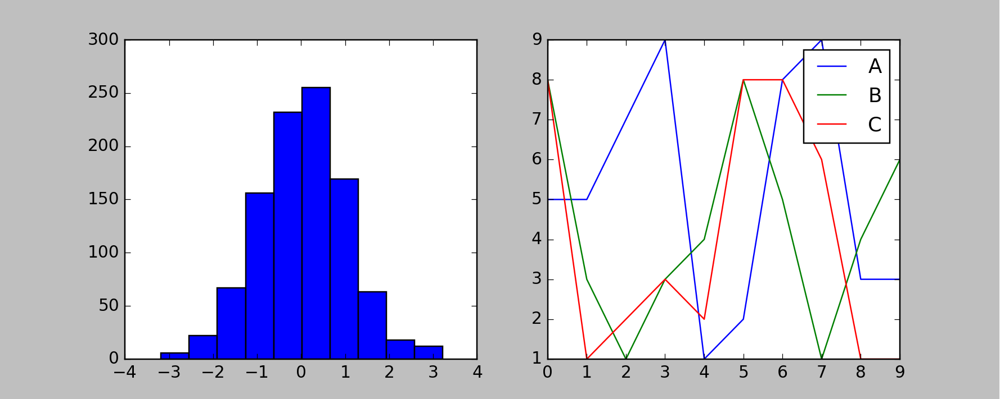

<IPython.core.display.Javascript object>


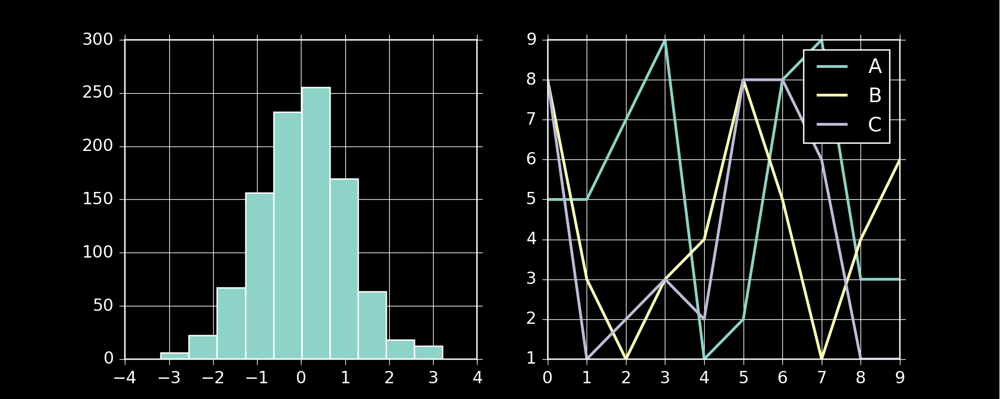

In [123]:
# Y creamos el gráfico para probar varias hojas de estilo.
styles = plt.style.available[:7]

for style_j in styles:
    with plt.style.context(style_j):
        fig, ax = plt.subplots(figsize=(10, 4), ncols=2)
        ax[0].hist(x)
        ax[1].plot(x1)
        ax[1].plot(x2)
        ax[1].plot(x3)
        ax[1].legend(["A", "B", "C"]);

## Comentarios finales.
En esta sección, hemos aprendido a personalizar todo tipo de elementos asociados a los gráficos que queramos construir por medio del uso de la librería **Matplotlib**. Sin embargo, a pesar de que los que hemos visto puede antojarse un tanto extenso, la documentación oficial de **Matplotlib** nos ofrece aún toneladas de información relativas a los aspectos que podemos controlar y/o personalizar en un gráfico. Por lo tanto, se recomienda siempre echarle un vistazo a tal documentación, ya que muchos *updates* de esta librería han ido añadiendo varias opciones interesantes.

En la siguiente sección, aprenderemos varias cosas relativas a la construcción de gráficos en tres dimensiones. Aprenderemos a construir superficies y enmallados a partir de arreglos de **Numpy**, y exploraremos la opción de crear gráficos combinados, tanto en 2D como en 3D, a fin de representar de forma precisa visualizaciones de todo tipo.